# 0 - Imports/Constants

In [1]:
import os
from pprint import pprint
from dataclasses import dataclass
from collections import Counter
import json
from xml.etree import ElementTree
from xml.etree.ElementTree import ParseError
from glob import glob
from PIL import Image
import matplotlib.pyplot as plt 
import random

import torch
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import transforms
import torch.nn as nn
import torch.backends.cudnn as cudnn

import nltk

from tqdm import tqdm

from filters import RelationFilter, POSRelationFilter, RuleBasedRelationFilter
from dataset import Datasets, ImageDataset, Sample, CLEFCaptionLoader, FlickrCaptionLoader, custom_collate, END_TOKEN, PADDING_TOKEN, START_TOKEN, UNKNOWN_TOKEN
from test import CaptionTester
from train import CaptionTrainer
from preproc import save_checkpoint, adjust_learning_rate
from main import train, split_dataset

In [2]:
# the if statement based on the on_server variable by Dominik, the different path and dir variables by both Dominik and Maria,
# added on as necessary.

on_server = False

if on_server:
    data_root_dir = '/srv/data/guskunkdo/'
    saved_root_dir = os.path.join(data_root_dir, 'saved/')
    model_path = '/srv/data/aics/03-image-captioning/data/BEST_checkpoint_flickr8k_5_10.pth.tar'  # model path updated
    word_map_path = '/srv/data/aics/03-image-captioning/data/out/wordmap_flickr8k_5_10.json'  # wordmap path updated
else:
    data_root_dir = '../data/'
    saved_root_dir = '../saved/'
    model_path = '../data/BEST_checkpoint_flickr8k_5_10.pth.tar'  # model path updated
    word_map_path = '../data/wordmap_flickr8k_5_10.json'  # wordmap path updated

clef_root_dir = os.path.join(data_root_dir, 'iaprtc12/')
clef_image_dir = os.path.join(clef_root_dir, 'images/')
clef_annotation_dir = os.path.join(clef_root_dir, 'annotations_complete_eng/')

flickr_root_dir = os.path.join(data_root_dir, 'flickr_8k/')
flickr_image_dir = os.path.join(flickr_root_dir, 'Images/')

In [3]:
# device, benchmark, training_parameters from Nikolai Ilinykh's code
# hyperparameters by Maria

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cudnn.benchmark = True  # set to true only if inputs to model are fixed size; otherwise lot of computational overhead

hyperparameters = {
    'number_of_images': 10000,
    
    'beam_size': 3,
    'smooth': False,
    
    'unk_filter': 1.0
}

# Training parameters
# TODO: see if this is necessary here
training_parameters = {
    'epochs': 120,  # number of epochs to train for (if early stopping is not triggered)
    'batch_size': 32,
    'workers': 1,  # for data-loading; right now, only 1 works with h5py
    'encoder_lr': 1e-4,  # learning rate for encoder if fine-tuning
    'decoder_lr': 4e-4,  # learning rate for decoder
    'grad_clip': 5.,  # clip gradients at an absolute value of
    'alpha_c': 1.,  # regularization parameter for 'doubly stochastic attention', as in the paper
    'print_freq': 100,  # print training/validation stats every __ batches
    'fine_tune_encoder': False,  # fine-tune encoder?
}

# 1 - Data loading 
For training, this part was mostly done by Dominik, with individual contributions by Maria marked in the code in most cases; that part of the code is available in separate files, ``filters.py, dataset.py``. The rule-based relation filter has been provided to us by Simon (**TODO ADD WHO ELSE?**) This data loading for testing is based on Dominik's code, done by Maria.

In [4]:
# this particular use of the filters.py and dataset.py code by Maria

# opening the original wordmap
with open(word_map_path, 'r') as j:
    word_map = json.load(j)

# creating test datasets, as we want the test runs to be comparable across the models; therefore we cannot just use the models'
# respective test sets. Although our datasets are split using a fixed seed, we cannot guarantee that using just, say, the test
# set from one of the models only will work, as it may include images that other models were trained on. For the same reason, we
# cannot just create another 5k dataset out of the blue and take its test split. In order to get around this, we are loading 10k
# datasets here, and we will only use their latter half (the other 5k images) to create data splits. This way the possibility of
# the test set including images from the training set is minimal. 

# we create 3 different datasets: flickr to see how the fine-tuned models perform on the original data, clef unfiltered to see
# how they perform on just about any clef images, and clef filtered, as the unfiltered one may include images with many unk items,
# leading to the model having no clue what they are, as similar images were excluded from the training.

clef_dataset_unfiltered = ImageDataset(image_directory=clef_image_dir,
                            relation_filter=POSRelationFilter(),
                            #relation_filter=RuleBasedRelationFilter(),
                            caption_loader=CLEFCaptionLoader(clef_annotation_dir),
                            number_images=hyperparameters['number_of_images'], 
                            word_map=word_map,
                            min_frequency=1,
                            concat_captions=False,
                            unk_filter=hyperparameters['unk_filter'])

clef_dataset_filtered = ImageDataset(image_directory=clef_image_dir,
                            relation_filter=POSRelationFilter(),
                            #relation_filter=RuleBasedRelationFilter(),
                            caption_loader=CLEFCaptionLoader(clef_annotation_dir),
                            number_images=hyperparameters['number_of_images'], 
                            word_map=word_map,
                            min_frequency=1,
                            concat_captions=False,
                            unk_filter=0.1)  # the most restrictive filter we have used

flickr_dataset = ImageDataset(image_directory=flickr_image_dir,
                              relation_filter=POSRelationFilter(),
                              #relation_filter=RuleBasedRelationFilter(),
                              caption_loader=FlickrCaptionLoader(flickr_root_dir),
                              number_images=hyperparameters['number_of_images'], 
                              word_map=word_map,
                              min_frequency=1,
                              unk_filter=hyperparameters['unk_filter'])

------CLEFCaptionLoader-------
17588 captions loaded!
10000 captions filtered.


Loading images...: 100%|█████████████████████████████████████████████████████████| 10000/10000 [01:00<00:00, 165.38it/s]


9999 images loaded!

------CLEFCaptionLoader-------
17588 captions loaded!
9588 captions filtered.


Loading images...: 100%|███████████████████████████████████████████████████████████| 9588/9588 [01:03<00:00, 151.62it/s]


9588 images loaded!

-----FlickrCaptionLoader------
40455 captions loaded!
10000 captions filtered.


Loading images...: 100%|█████████████████████████████████████████████████████████| 10000/10000 [01:09<00:00, 143.48it/s]


10000 images loaded!



In [5]:
# by Maria
# since the seed is fixed, these splits should always include the same images, therefore it is not necessary to save them

_, _, test_set_clef_unf = split_dataset(clef_dataset_unfiltered[5000:])

_, _, test_set_clef_f = split_dataset(clef_dataset_filtered[5000:])

_, _, test_set_flickr = split_dataset(flickr_dataset[5000:])

-------Dataset lengths--------
train: 3999, val: 499, test: 501
-------Dataset lengths--------
train: 3670, val: 458, test: 460
-------Dataset lengths--------
train: 4000, val: 500, test: 500


# 2 - Testing the pretrained model (by Nikolai Ilinykh)
This part is mostly done by Nikolai, adapted for our use by Maria (changes marked by comments in the code), with individual contributions from Dominik marked in the code. Moving some of the code into ``test.py`` was done by Dominik.

In [6]:
# test dataloaders and fixed-random subselections of the test datasets by Maria.

# creating dataloaders for testing purposes, batch size 1 for ease of testing, no shuffle is needed, no drop last is needed
# since ~500 images is a lot to analyze qualitatively, we will select, at random, 50 images from each set, with a fixed seed
# for reproducible results.

random.seed(25)

test_dataloader_clef_unf = DataLoader(
    dataset=random.sample(list(test_set_clef_unf), 20), 
    batch_size=1, 
    shuffle=False, 
    collate_fn=custom_collate, 
)

test_dataloader_clef_f = DataLoader(
    dataset=random.sample(list(test_set_clef_f), 20), 
    batch_size=1, 
    shuffle=False, 
    collate_fn=custom_collate, 
)

test_dataloader_flickr = DataLoader(
    dataset=random.sample(list(test_set_flickr), 20), 
    batch_size=1, 
    shuffle=False, 
    collate_fn=custom_collate, 
)

In [7]:
# a CaptionTester object for the original model.
tester = CaptionTester(model_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]/mnt/c/Users/turti/OneDrive/Dokumenty/GitHub/aics-project/code/test.py:77: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ../torch/csrc/utils/tensor_numpy.cpp:199.)
  img = torch.FloatTensor(img).to(self.device)


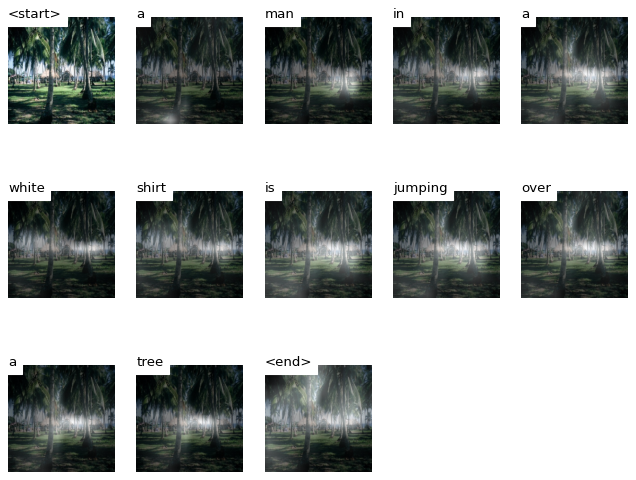

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:07<02:21,  7.43s/it]

Image file name: ../data/iaprtc12/images/15/15551.jpg


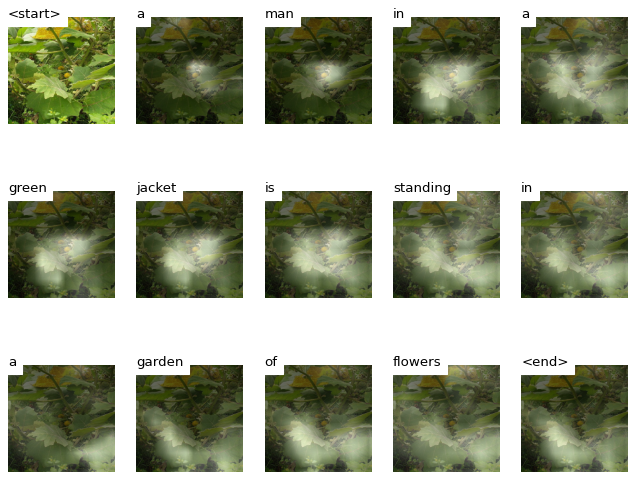

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:10<01:24,  4.68s/it]

Image file name: ../data/iaprtc12/images/20/20144.jpg


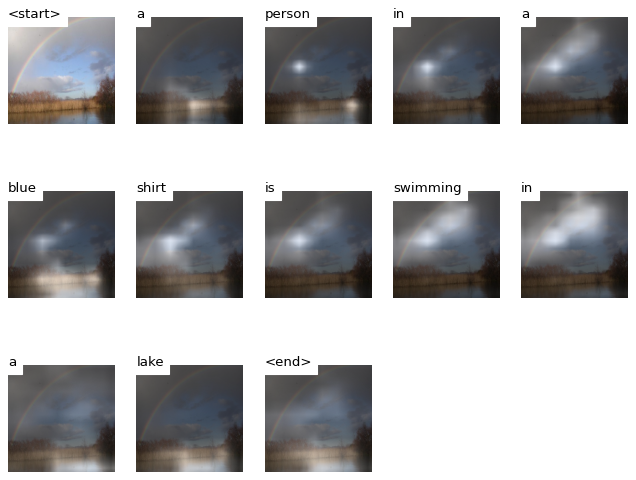

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:15<01:23,  4.90s/it]

Image file name: ../data/iaprtc12/images/20/20343.jpg


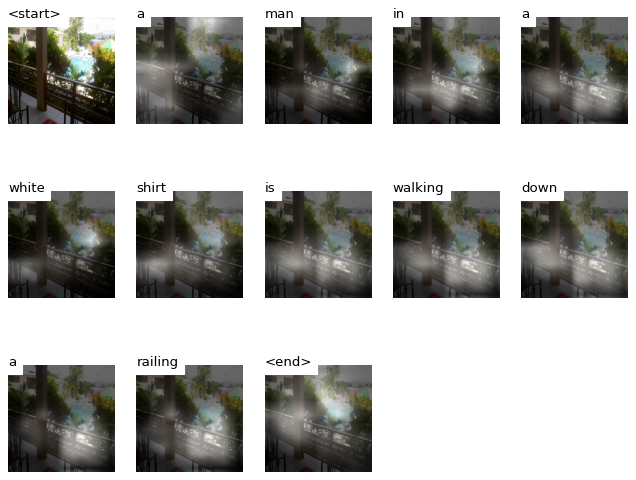

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:17<00:59,  3.72s/it]

Image file name: ../data/iaprtc12/images/12/12761.jpg


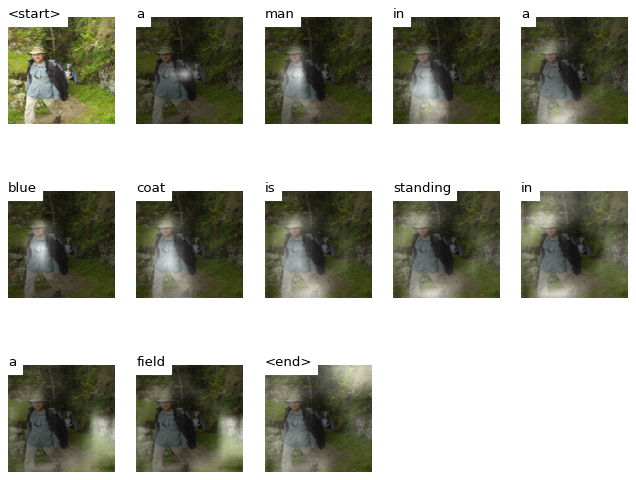

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:19<00:47,  3.15s/it]

Image file name: ../data/iaprtc12/images/22/22381.jpg


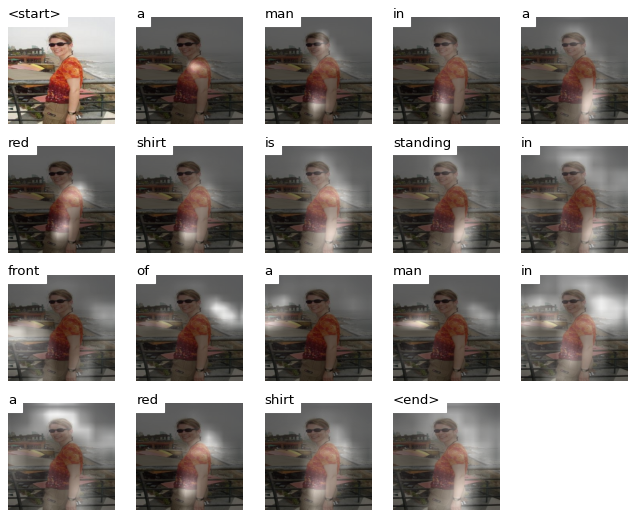

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:22<00:45,  3.22s/it]

Image file name: ../data/iaprtc12/images/10/10821.jpg


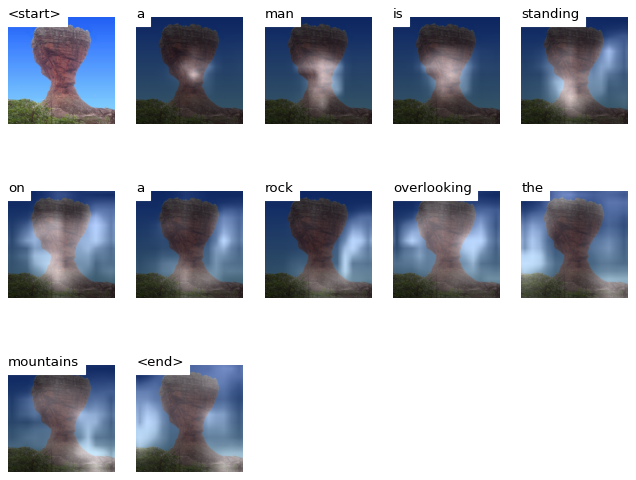

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:24<00:35,  2.75s/it]

Image file name: ../data/iaprtc12/images/18/18448.jpg


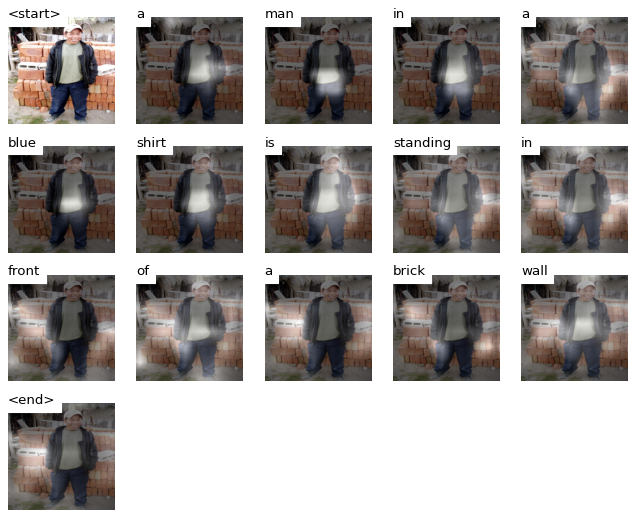

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:26<00:31,  2.63s/it]

Image file name: ../data/iaprtc12/images/17/17173.jpg


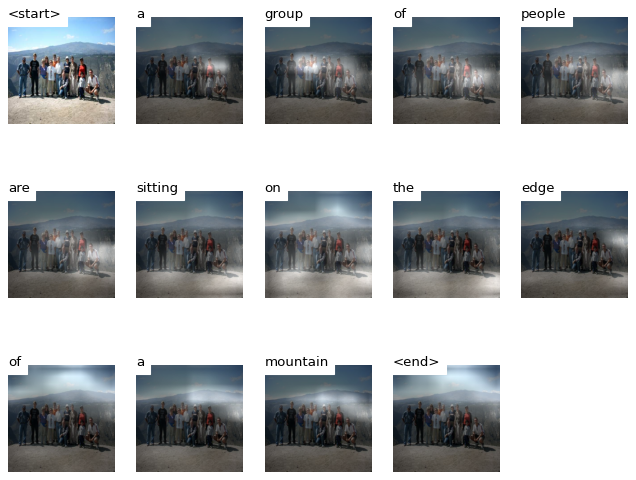

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:29<00:27,  2.53s/it]

Image file name: ../data/iaprtc12/images/13/13152.jpg


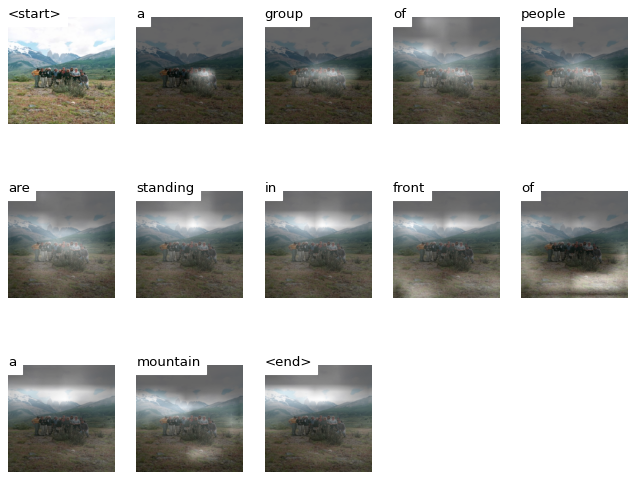

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:31<00:24,  2.48s/it]

Image file name: ../data/iaprtc12/images/20/20272.jpg


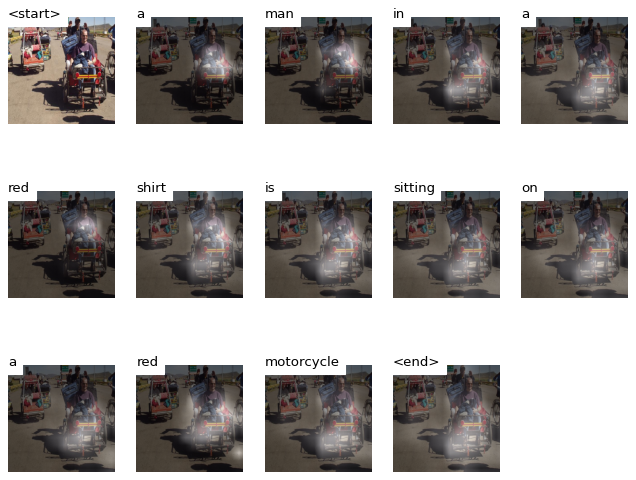

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:33<00:21,  2.34s/it]

Image file name: ../data/iaprtc12/images/11/11310.jpg


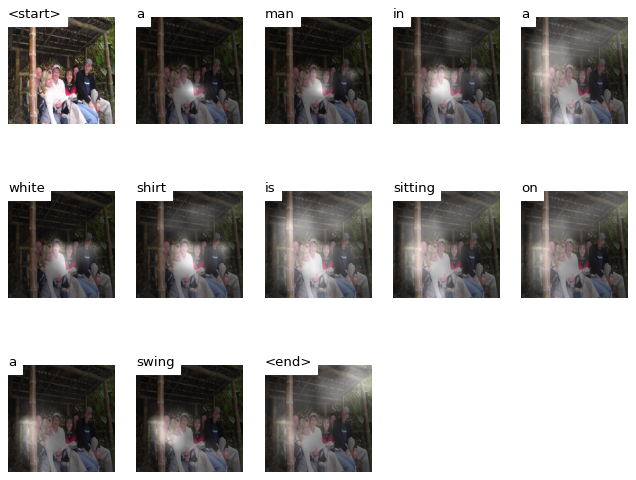

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:35<00:17,  2.25s/it]

Image file name: ../data/iaprtc12/images/14/14183.jpg


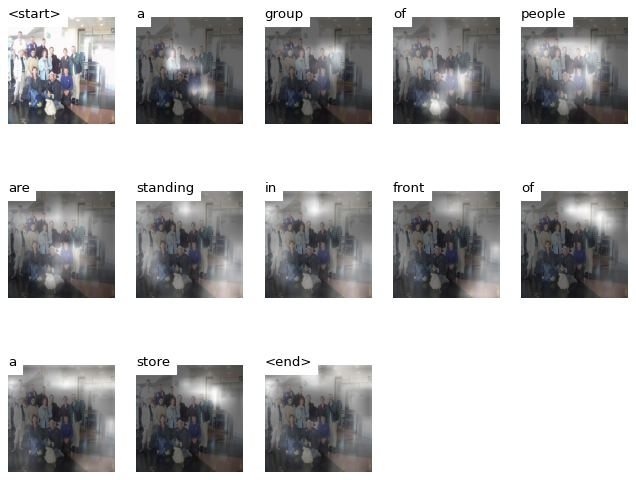

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:37<00:15,  2.16s/it]

Image file name: ../data/iaprtc12/images/10/10622.jpg


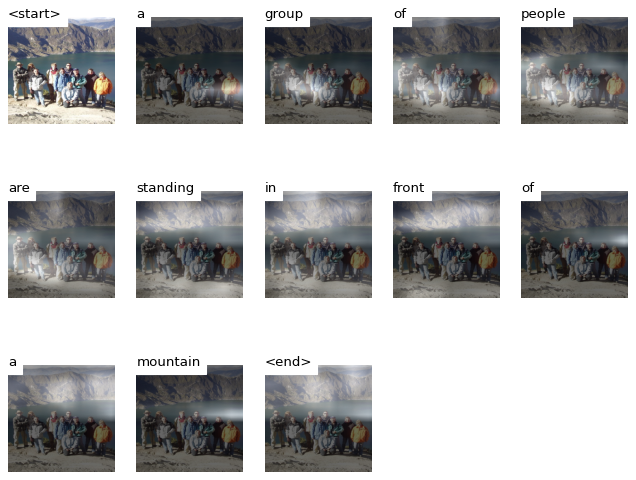

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:39<00:12,  2.11s/it]

Image file name: ../data/iaprtc12/images/13/13123.jpg


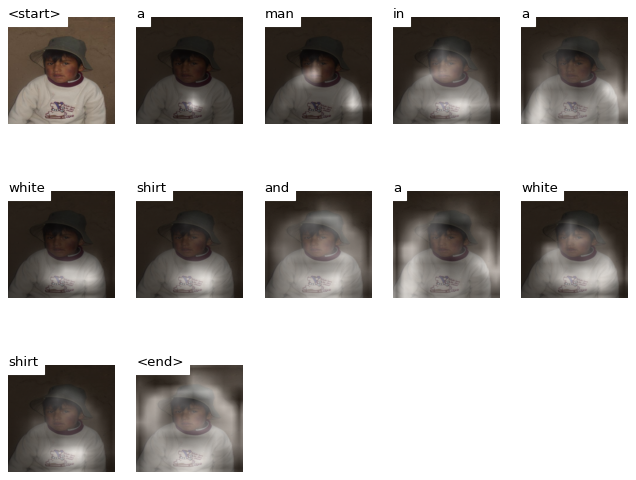

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:41<00:10,  2.10s/it]

Image file name: ../data/iaprtc12/images/19/19181.jpg


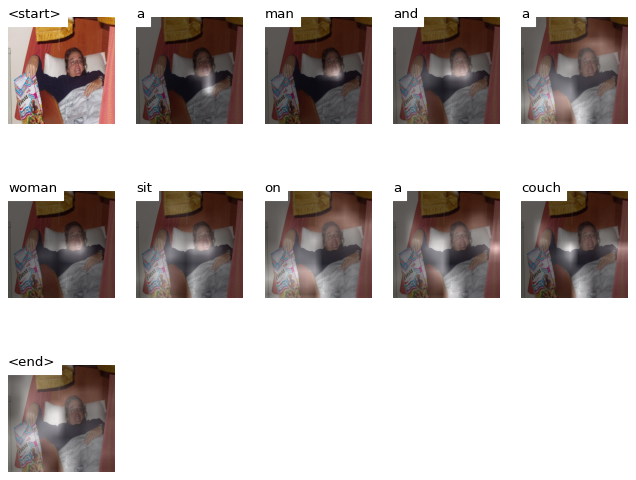

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:43<00:07,  1.96s/it]

Image file name: ../data/iaprtc12/images/16/16920.jpg


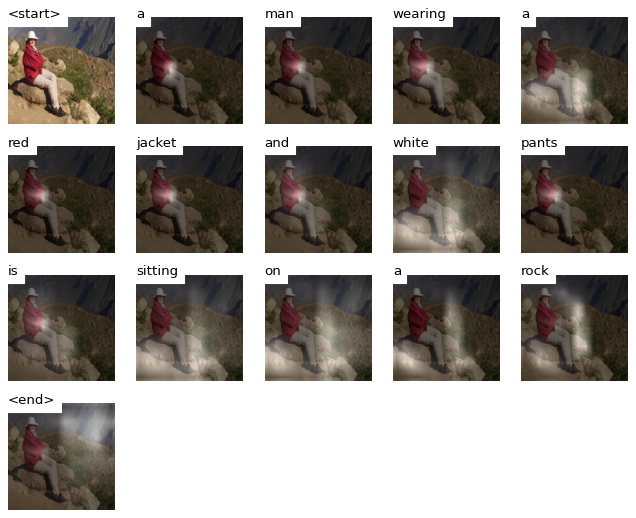

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:45<00:06,  2.05s/it]

Image file name: ../data/iaprtc12/images/11/11308.jpg


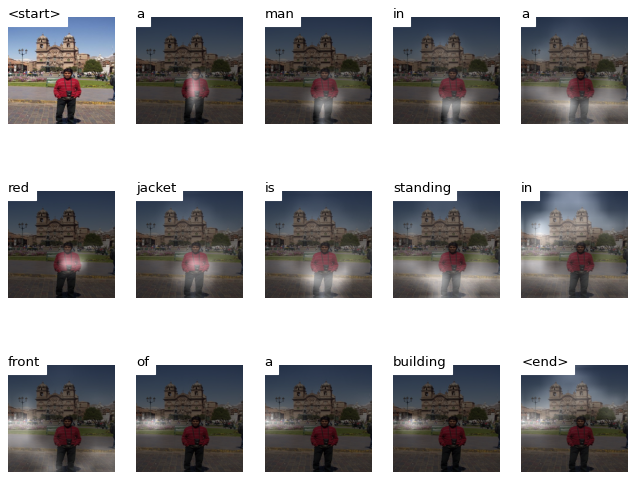

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:47<00:04,  2.14s/it]

Image file name: ../data/iaprtc12/images/14/14016.jpg


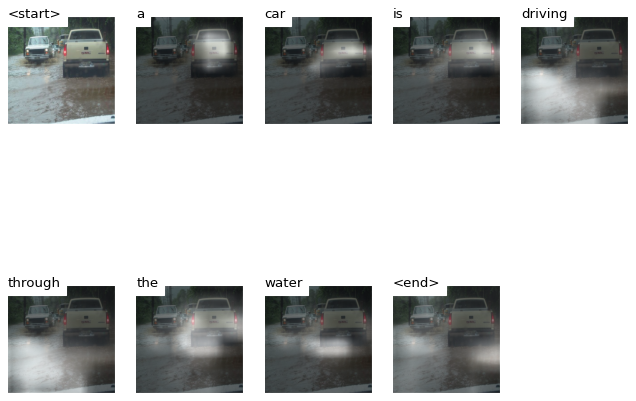

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:49<00:01,  1.93s/it]

Image file name: ../data/iaprtc12/images/21/21029.jpg


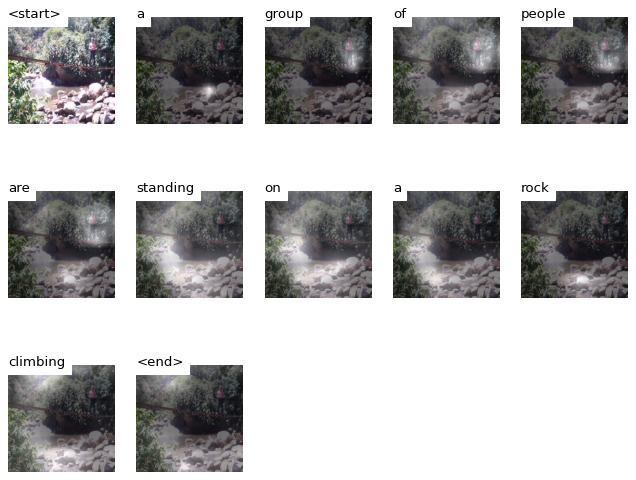

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:51<00:00,  2.56s/it]

Image file name: ../data/iaprtc12/images/18/18355.jpg


In [8]:
# all the following testing loops (and their try statements) by Maria.

# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

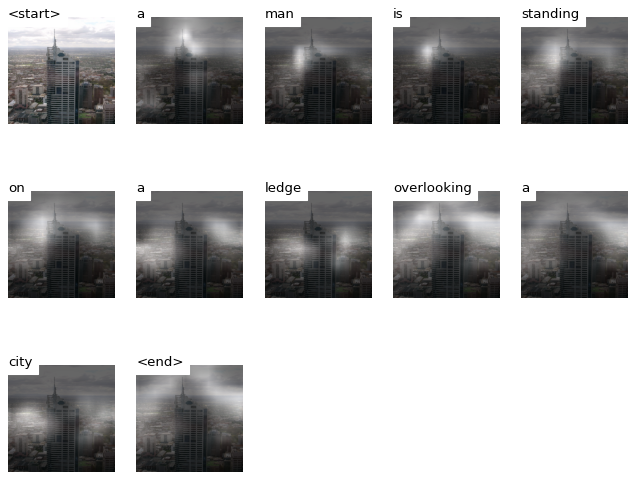

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:01<00:34,  1.84s/it]

Image file name: ../data/iaprtc12/images/40/40416.jpg


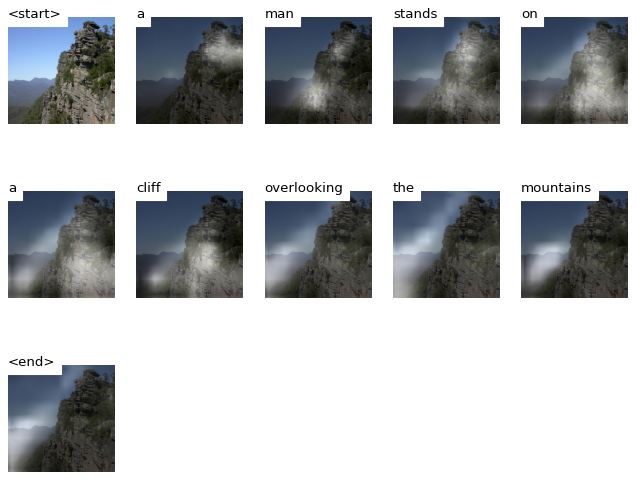

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:03<00:32,  1.80s/it]

Image file name: ../data/iaprtc12/images/39/39158.jpg


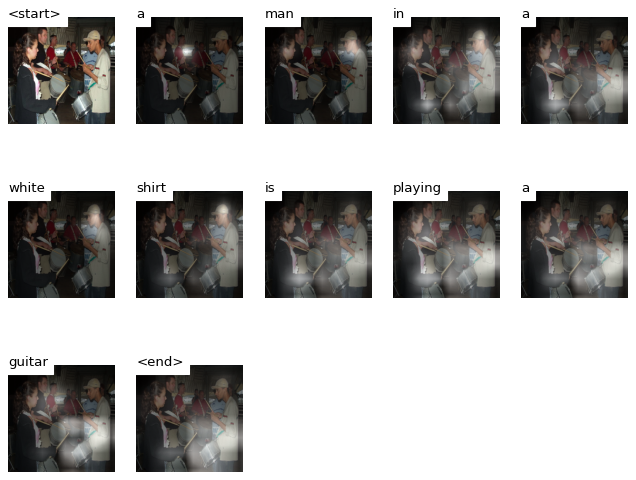

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:05<00:32,  1.93s/it]

Image file name: ../data/iaprtc12/images/25/25053.jpg


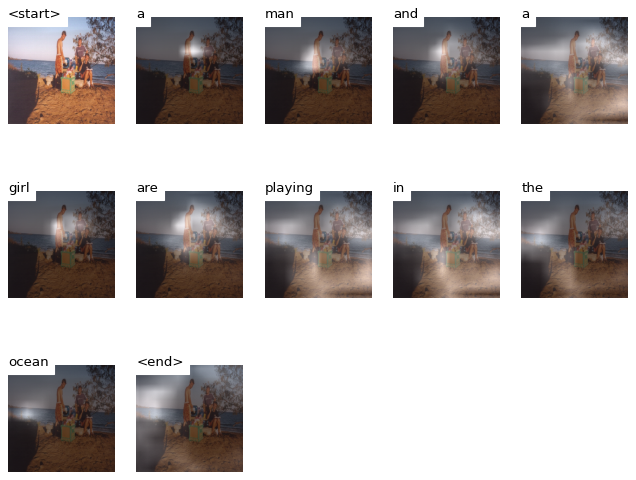

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:07<00:30,  1.90s/it]

Image file name: ../data/iaprtc12/images/30/30620.jpg


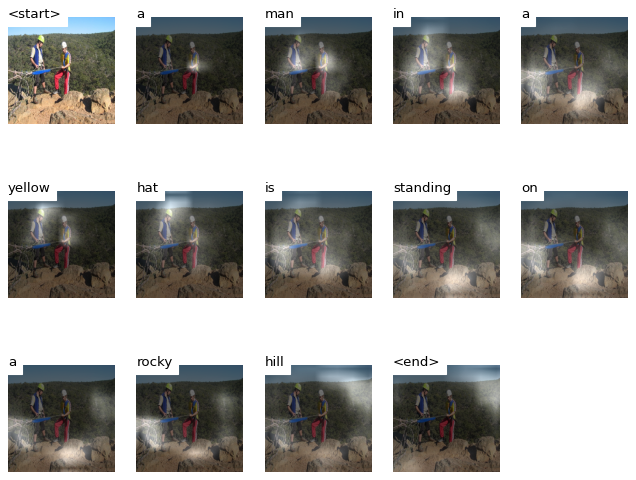

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:09<00:29,  1.96s/it]

Image file name: ../data/iaprtc12/images/32/32397.jpg


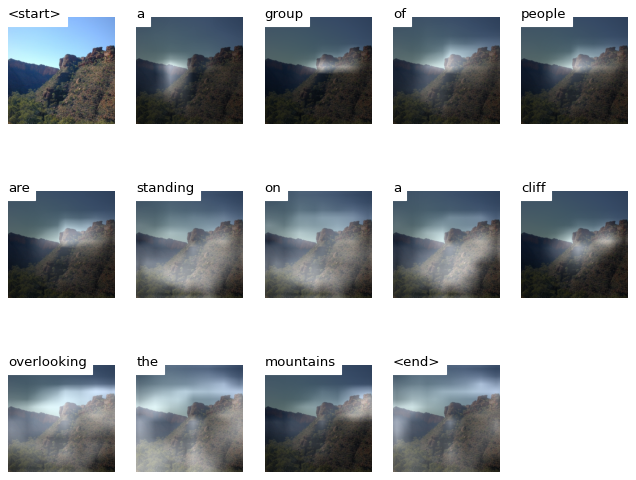

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:11<00:29,  2.08s/it]

Image file name: ../data/iaprtc12/images/38/38937.jpg


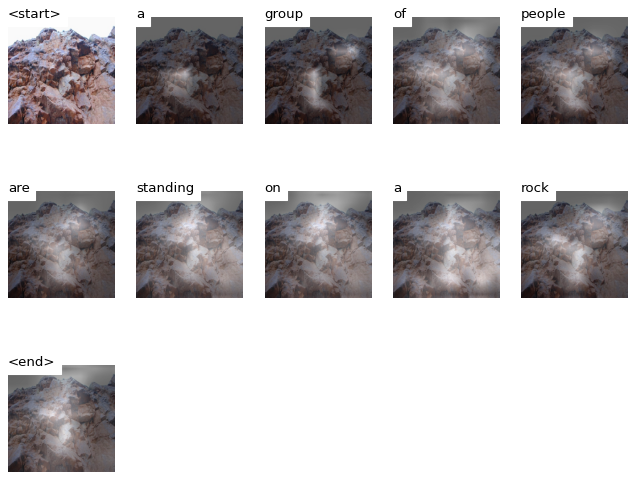

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:13<00:26,  2.03s/it]

Image file name: ../data/iaprtc12/images/39/39005.jpg


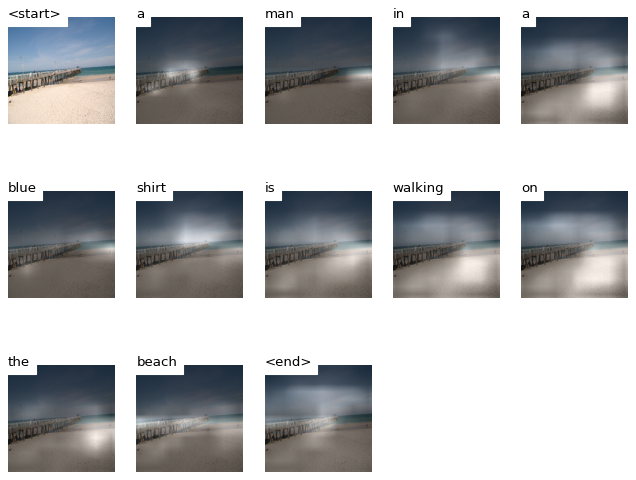

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:16<00:24,  2.07s/it]

Image file name: ../data/iaprtc12/images/40/40120.jpg


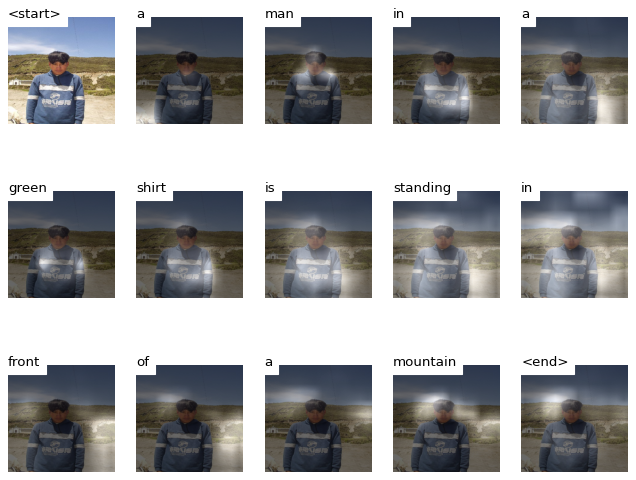

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:18<00:23,  2.16s/it]

Image file name: ../data/iaprtc12/images/23/23588.jpg


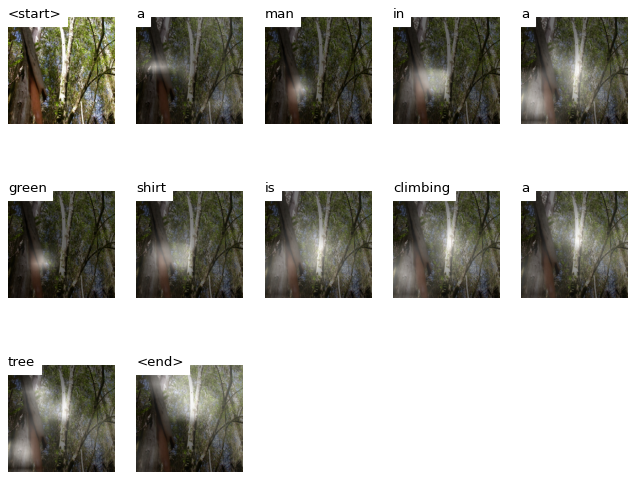

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:20<00:20,  2.06s/it]

Image file name: ../data/iaprtc12/images/39/39472.jpg


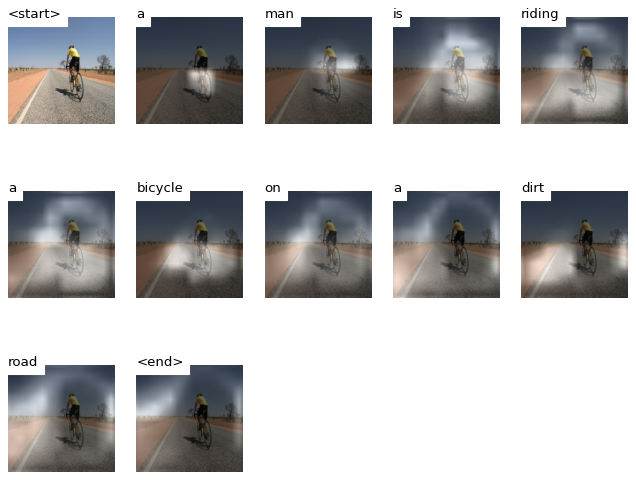

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:22<00:18,  2.04s/it]

Image file name: ../data/iaprtc12/images/30/30138.jpg


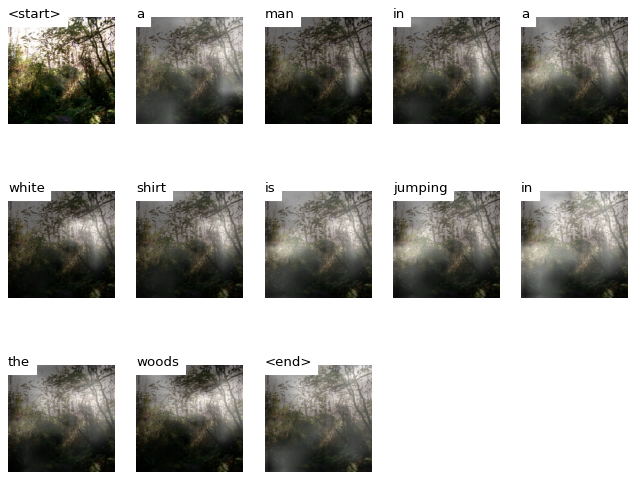

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:24<00:16,  2.00s/it]

Image file name: ../data/iaprtc12/images/40/40202.jpg


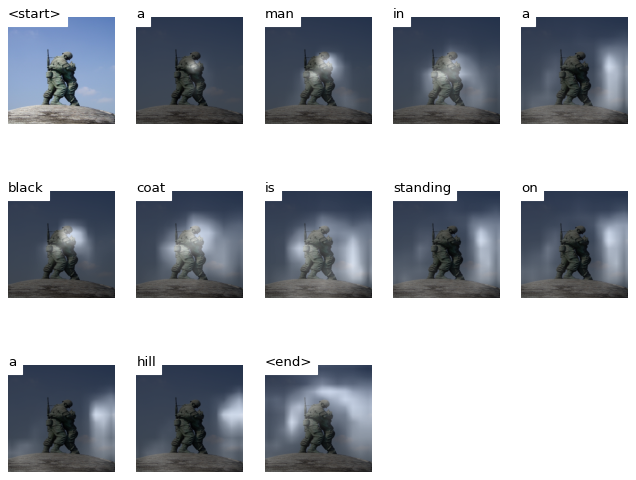

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:26<00:14,  2.01s/it]

Image file name: ../data/iaprtc12/images/35/35895.jpg


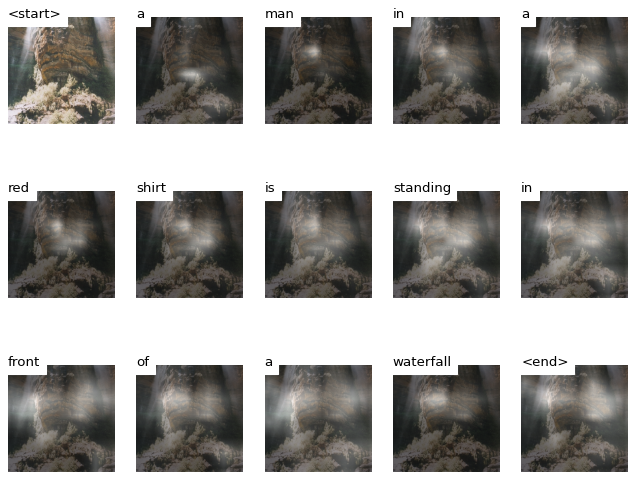

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:28<00:12,  2.08s/it]

Image file name: ../data/iaprtc12/images/32/32663.jpg


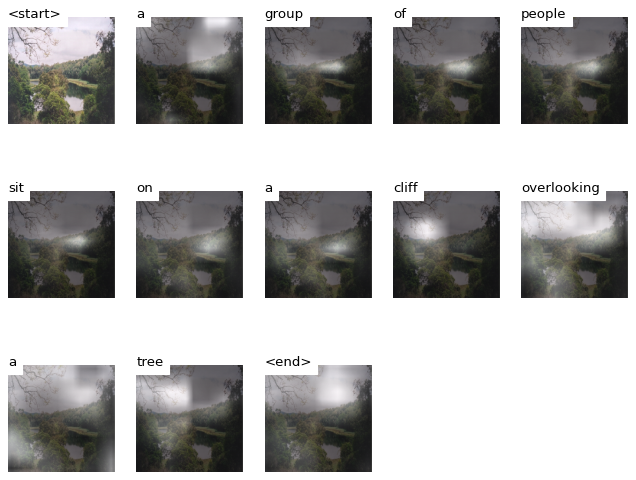

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:30<00:10,  2.15s/it]

Image file name: ../data/iaprtc12/images/30/30705.jpg


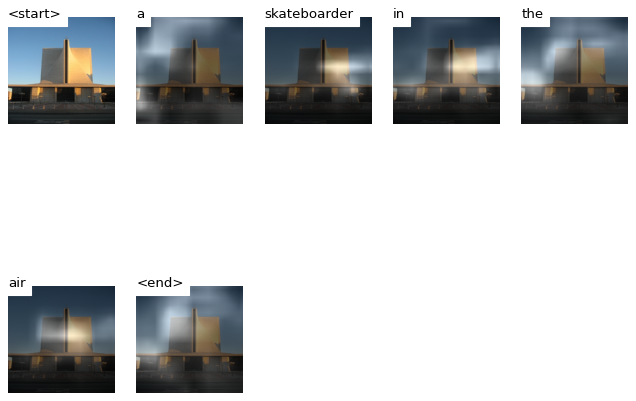

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:31<00:07,  1.85s/it]

Image file name: ../data/iaprtc12/images/38/38081.jpg


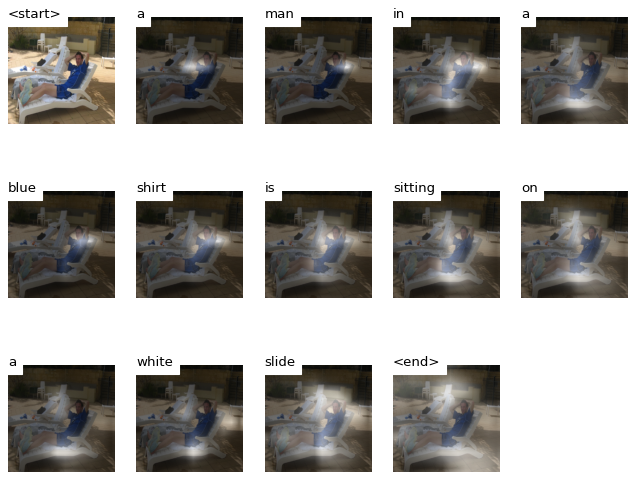

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:33<00:05,  1.92s/it]

Image file name: ../data/iaprtc12/images/31/31571.jpg


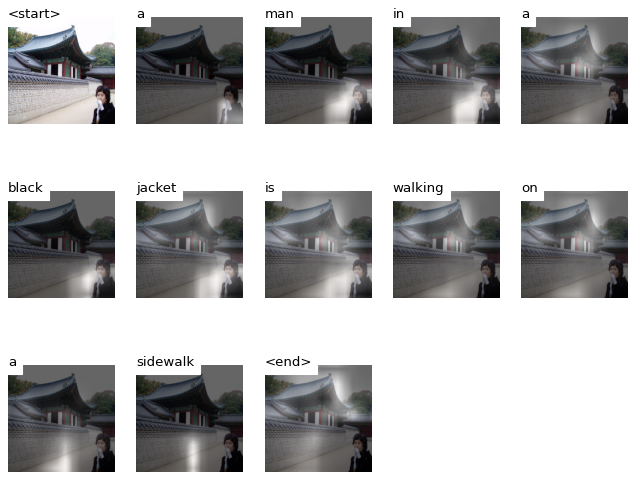

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:35<00:03,  1.95s/it]

Image file name: ../data/iaprtc12/images/35/35858.jpg


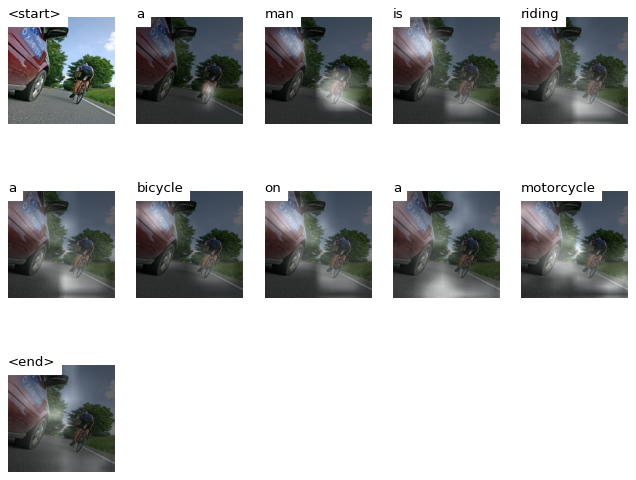

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:37<00:01,  1.88s/it]

Image file name: ../data/iaprtc12/images/37/37836.jpg


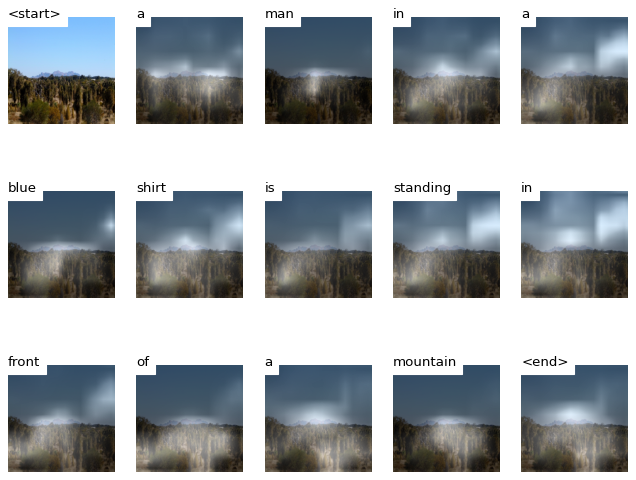

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:40<00:00,  2.01s/it]

Image file name: ../data/iaprtc12/images/39/39239.jpg


In [9]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

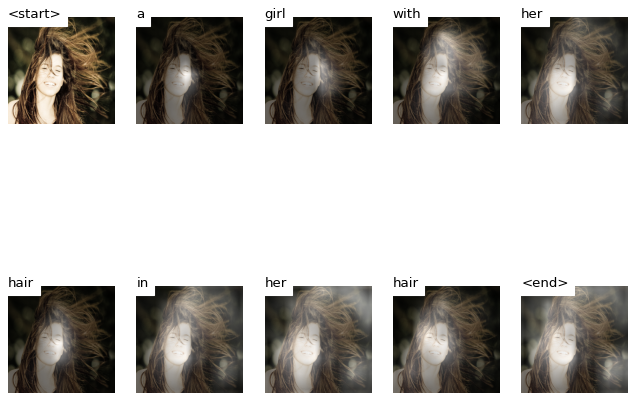

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:01<00:30,  1.62s/it]

Image file name: ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg


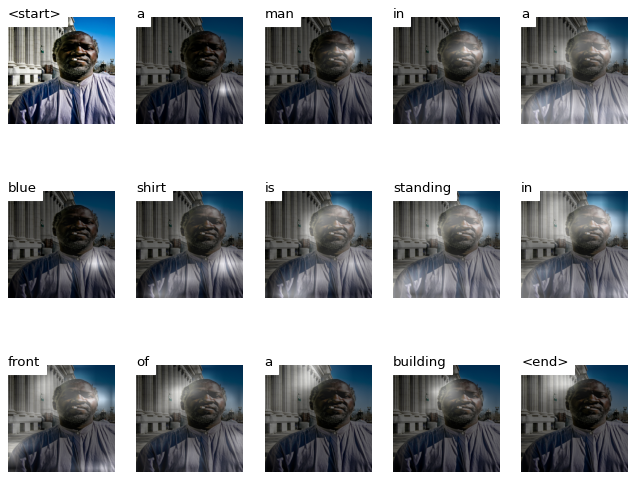

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:03<00:36,  2.03s/it]

Image file name: ../data/flickr_8k/Images/2316097768_ef662f444b.jpg


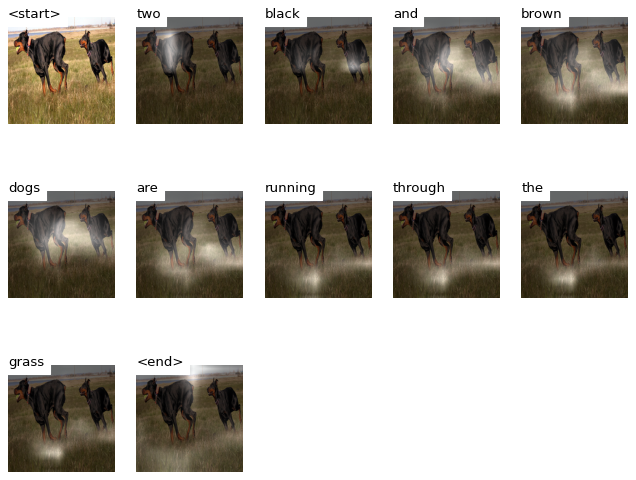

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:05<00:33,  1.96s/it]

Image file name: ../data/flickr_8k/Images/2439384468_58934deab6.jpg


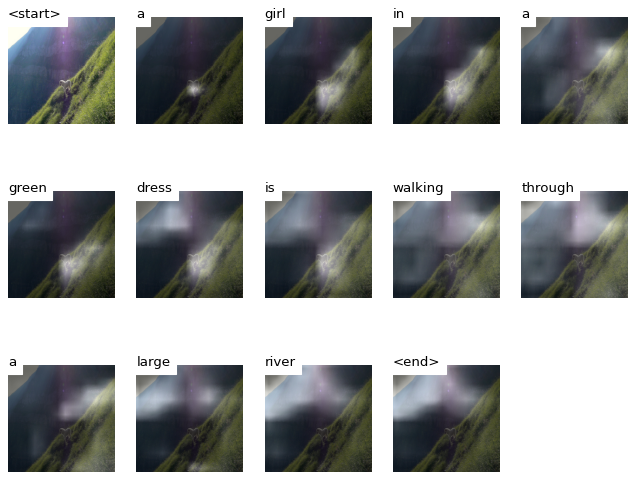

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:08<00:33,  2.12s/it]

Image file name: ../data/flickr_8k/Images/2112921744_92bf706805.jpg


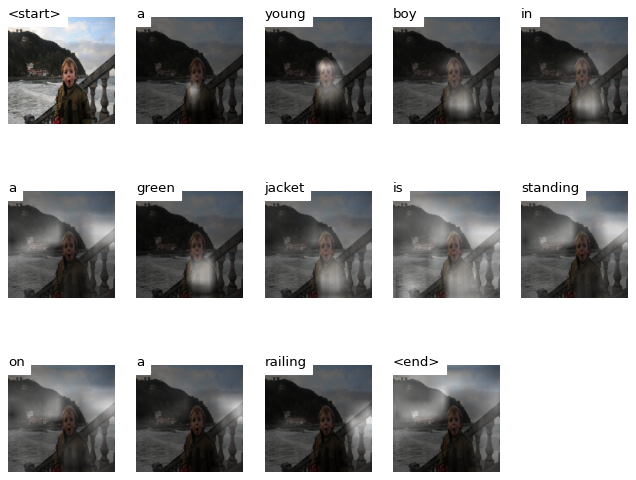

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:10<00:31,  2.12s/it]

Image file name: ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg


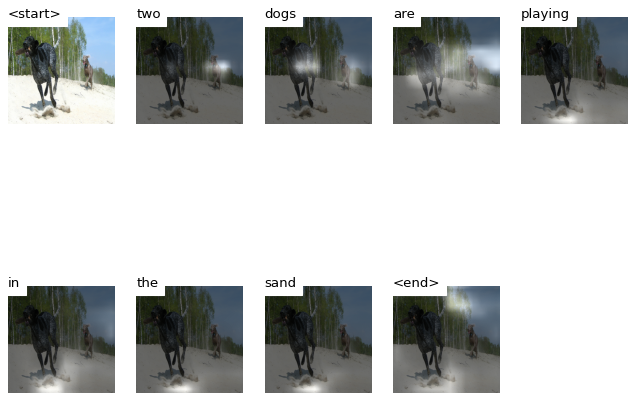

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:11<00:26,  1.87s/it]

Image file name: ../data/flickr_8k/Images/2434006663_207a284cec.jpg


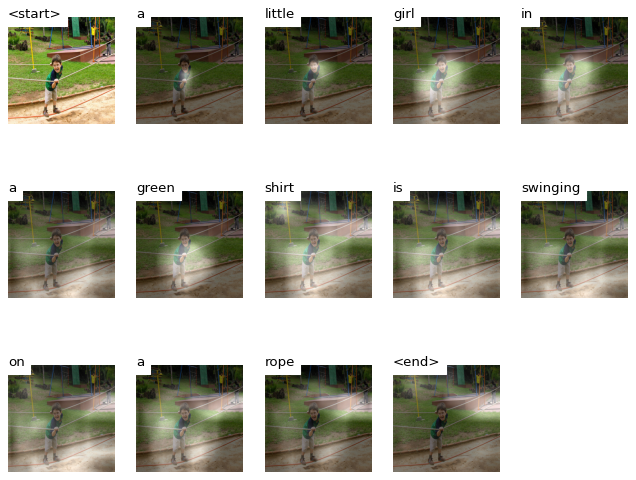

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:13<00:25,  1.94s/it]

Image file name: ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg


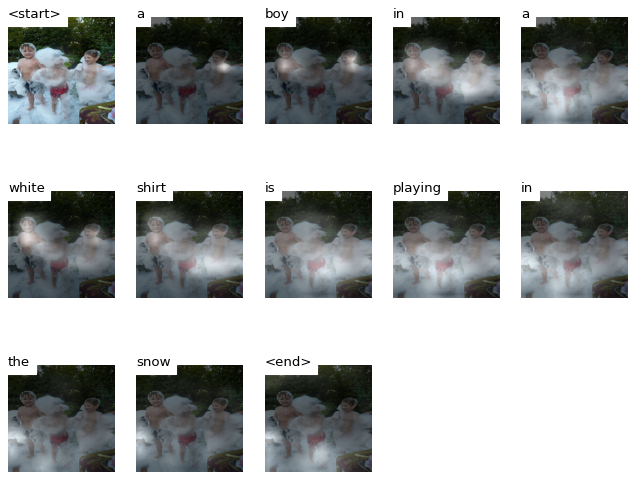

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:16<00:24,  2.07s/it]

Image file name: ../data/flickr_8k/Images/2111360187_d2505437b7.jpg


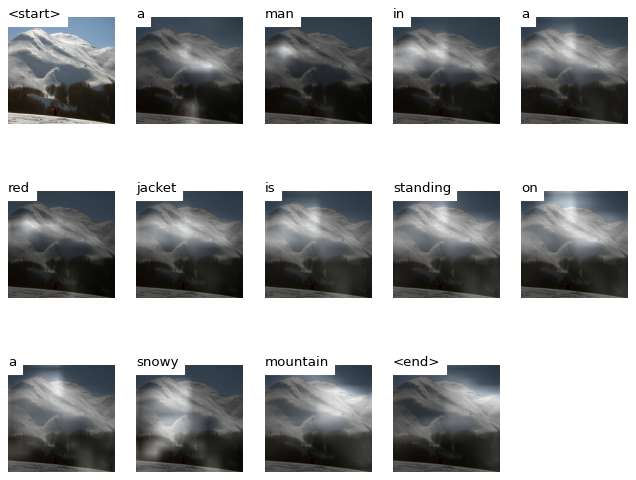

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:18<00:22,  2.04s/it]

Image file name: ../data/flickr_8k/Images/2271671533_7538ccd556.jpg


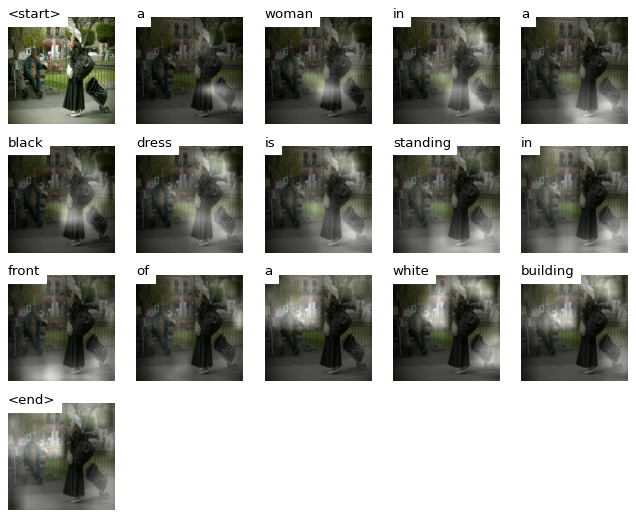

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:20<00:21,  2.11s/it]

Image file name: ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg


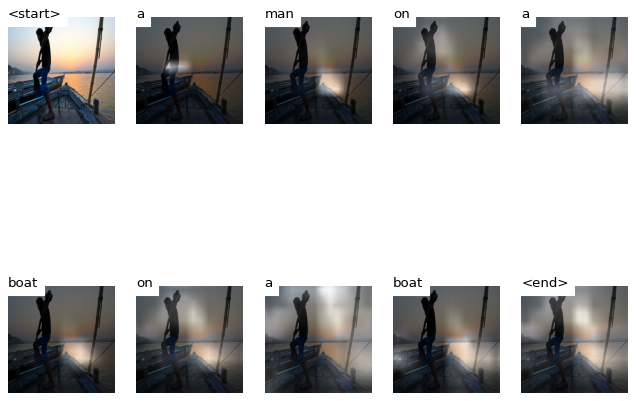

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:21<00:17,  1.93s/it]

Image file name: ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg


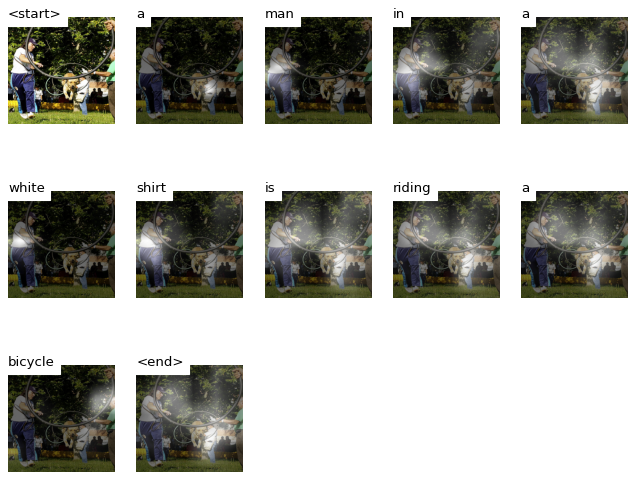

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:23<00:15,  1.97s/it]

Image file name: ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg


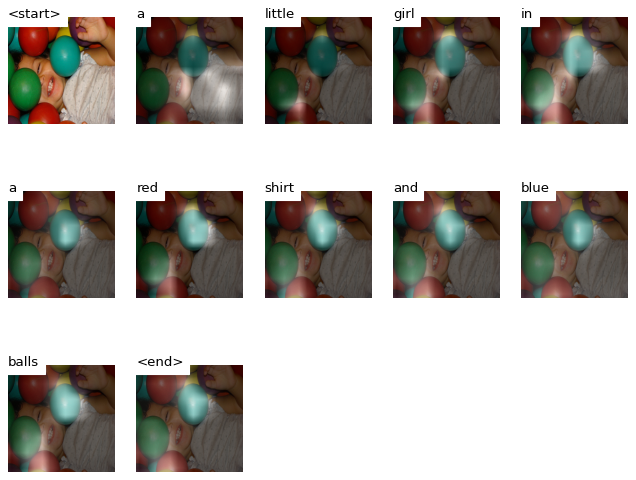

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:25<00:13,  1.97s/it]

Image file name: ../data/flickr_8k/Images/2279980395_989d48ae72.jpg


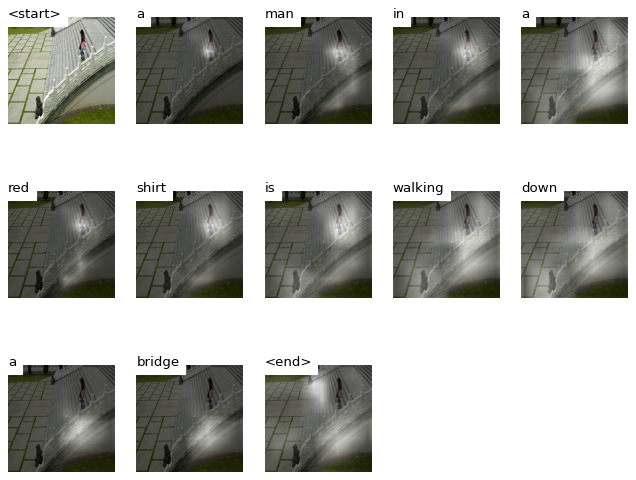

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:27<00:11,  1.97s/it]

Image file name: ../data/flickr_8k/Images/2393971707_bce01ae754.jpg


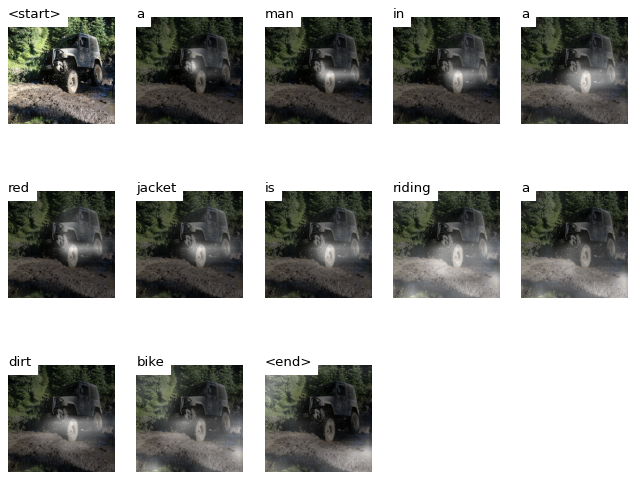

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:29<00:09,  1.94s/it]

Image file name: ../data/flickr_8k/Images/211277478_7d43aaee09.jpg


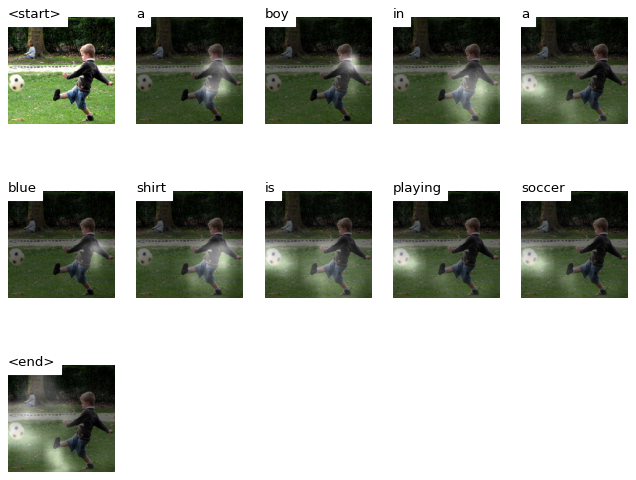

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:31<00:07,  1.85s/it]

Image file name: ../data/flickr_8k/Images/2337919839_df83827fa0.jpg


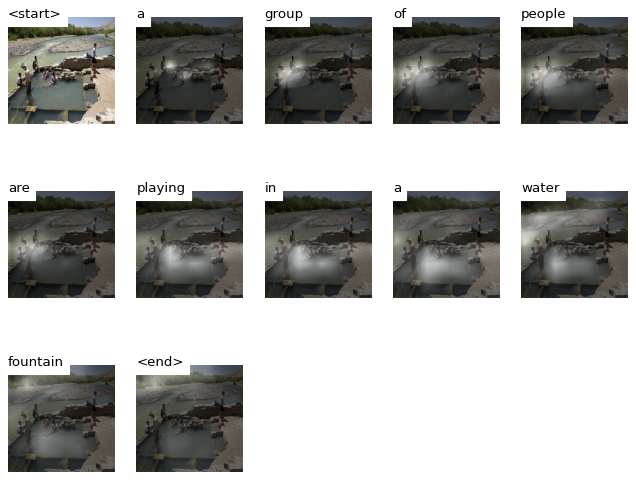

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:33<00:05,  1.92s/it]

Image file name: ../data/flickr_8k/Images/2447035752_415f4bb152.jpg


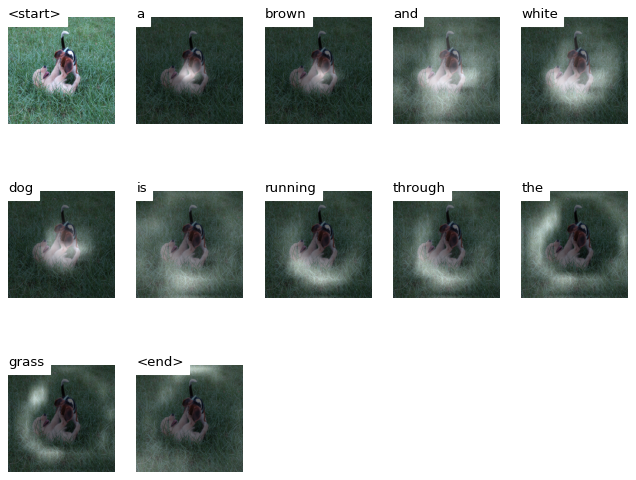

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:35<00:03,  1.93s/it]

Image file name: ../data/flickr_8k/Images/23445819_3a458716c1.jpg


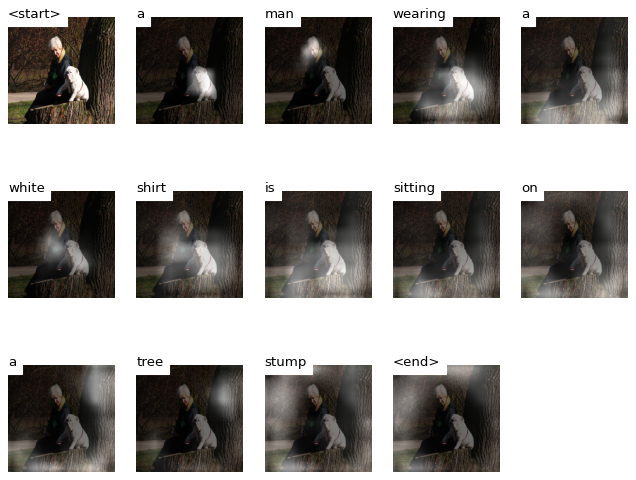

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:37<00:01,  1.95s/it]

Image file name: ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg


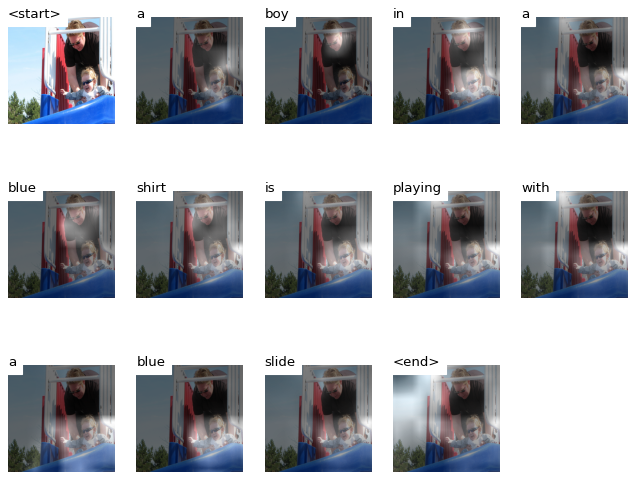

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:39<00:00,  1.98s/it]

Image file name: ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg


In [10]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

# 3 - Fine-tuning the model (by Nikolai Ilinykh)
This part is mostly done by Nikolai, adapted for our use by Maria (changes marked by comments in the code), with individual contributions from Dominik marked in the code. This is now located in a separate file, ``main.py`` and the moving of the code into a separate file has been done by Dominik. ``train.py`` is taken from the original project by Nikolai.

In [11]:
#train(checkpoint_name=f'imageCLEF_{hyperparameters["number_of_images"]}_{hyperparameters["unk_filter"]}', 
      #train_set=train_set,
      #val_set=val_set,
      #word_map=word_map,
      #saved_root_dir=saved_root_dir,
      #model_path=model_path,
      #device=device)

# 4 - Testing the fine-tuned model
Again, with a lot of the code based on Nikolai's work, a significant portion of this is analogous to the testing of the non-finetuned model done by Maria, and with contributions by Dominik. In this case though, we use the models that were finetuned on the server using specific hyperparameters. The final fine-tuning was done by Dominik.

### 2000k, 0.1 filter

In [12]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_2000_0.1.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

In [13]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:15,  1.26it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:14,  1.26it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:14,  1.18it/s]

No caption could be generated for ../data/iaprtc12/images/20/20343.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:03<00:14,  1.08it/s]

No caption could be generated for ../data/iaprtc12/images/12/12761.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:04<00:12,  1.24it/s]

No caption could be generated for ../data/iaprtc12/images/22/22381.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:04<00:10,  1.38it/s]

No caption could be generated for ../data/iaprtc12/images/10/10821.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:05<00:08,  1.50it/s]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:05<00:07,  1.58it/s]

No caption could be generated for ../data/iaprtc12/images/17/17173.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:06<00:06,  1.63it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:06<00:05,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:07<00:05,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/11/11310.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:08<00:04,  1.74it/s]

No caption could be generated for ../data/iaprtc12/images/14/14183.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:08<00:04,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/10/10622.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:09<00:03,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/13/13123.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:09<00:02,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:10<00:02,  1.68it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:11<00:01,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/11/11308.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:11<00:01,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/14/14016.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:12<00:00,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/21/21029.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:12<00:00,  1.57it/s]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [14]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:11,  1.73it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:10,  1.79it/s]

No caption could be generated for ../data/iaprtc12/images/39/39158.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.80it/s]

No caption could be generated for ../data/iaprtc12/images/25/25053.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:09,  1.78it/s]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:02<00:08,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/32/32397.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:08,  1.73it/s]

No caption could be generated for ../data/iaprtc12/images/38/38937.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:03<00:07,  1.74it/s]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:06,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.73it/s]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:05<00:05,  1.72it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.72it/s]

No caption could be generated for ../data/iaprtc12/images/30/30138.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:06<00:04,  1.72it/s]

No caption could be generated for ../data/iaprtc12/images/40/40202.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:04,  1.72it/s]

No caption could be generated for ../data/iaprtc12/images/35/35895.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.78it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:09<00:01,  1.79it/s]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.81it/s]

No caption could be generated for ../data/iaprtc12/images/35/35858.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:10<00:00,  1.80it/s]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/39/39239.jpg.


In [15]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.79it/s]

No caption could be generated for ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:09,  1.82it/s]

No caption could be generated for ../data/flickr_8k/Images/2316097768_ef662f444b.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.84it/s]

No caption could be generated for ../data/flickr_8k/Images/2439384468_58934deab6.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:08,  1.81it/s]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:02<00:08,  1.78it/s]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:07,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:03<00:07,  1.71it/s]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:07,  1.68it/s]

No caption could be generated for ../data/flickr_8k/Images/2111360187_d2505437b7.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.64it/s]

No caption could be generated for ../data/flickr_8k/Images/2271671533_7538ccd556.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:05<00:06,  1.65it/s]

No caption could be generated for ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.66it/s]

No caption could be generated for ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:06<00:04,  1.69it/s]

No caption could be generated for ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:04,  1.68it/s]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.70it/s]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.69it/s]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.69it/s]

No caption could be generated for ../data/flickr_8k/Images/2337919839_df83827fa0.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:09<00:01,  1.71it/s]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.71it/s]

No caption could be generated for ../data/flickr_8k/Images/23445819_3a458716c1.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:11<00:00,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.71it/s]

No caption could be generated for ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg.


### 2000k, 0.15 filter

In [16]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_2000_0.15.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:13,  1.43it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:12,  1.41it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:12,  1.38it/s]

No caption could be generated for ../data/iaprtc12/images/20/20343.jpg.


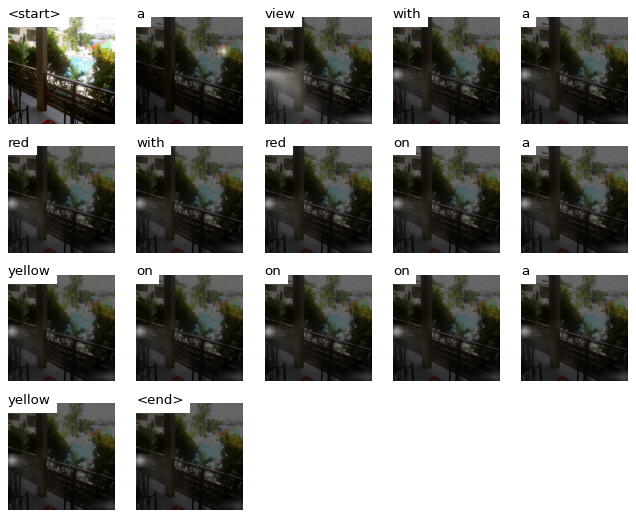

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:04<00:23,  1.45s/it]

Image file name: ../data/iaprtc12/images/12/12761.jpg


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:05<00:18,  1.21s/it]

No caption could be generated for ../data/iaprtc12/images/22/22381.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:06<00:15,  1.10s/it]

No caption could be generated for ../data/iaprtc12/images/10/10821.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:07<00:13,  1.03s/it]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:08<00:12,  1.01s/it]

No caption could be generated for ../data/iaprtc12/images/17/17173.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:09<00:10,  1.02it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:09<00:08,  1.15it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:10<00:07,  1.13it/s]

No caption could be generated for ../data/iaprtc12/images/11/11310.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:11<00:06,  1.14it/s]

No caption could be generated for ../data/iaprtc12/images/14/14183.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:12<00:06,  1.15it/s]

No caption could be generated for ../data/iaprtc12/images/10/10622.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:13<00:05,  1.12it/s]

No caption could be generated for ../data/iaprtc12/images/13/13123.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:14<00:04,  1.06it/s]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:15<00:03,  1.06it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:16<00:03,  1.01s/it]

No caption could be generated for ../data/iaprtc12/images/11/11308.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:17<00:02,  1.01s/it]

No caption could be generated for ../data/iaprtc12/images/14/14016.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:18<00:00,  1.03it/s]

No caption could be generated for ../data/iaprtc12/images/21/21029.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:19<00:00,  1.03it/s]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [17]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

In [18]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:16,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:15,  1.16it/s]

No caption could be generated for ../data/iaprtc12/images/39/39158.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:14,  1.16it/s]

No caption could be generated for ../data/iaprtc12/images/25/25053.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:03<00:13,  1.18it/s]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:04<00:12,  1.18it/s]

No caption could be generated for ../data/iaprtc12/images/32/32397.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:05<00:11,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/38/38937.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:05<00:11,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:06<00:10,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:07<00:09,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:08<00:08,  1.16it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:09<00:07,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/30/30138.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:10<00:06,  1.17it/s]

No caption could be generated for ../data/iaprtc12/images/40/40202.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:11<00:06,  1.16it/s]

No caption could be generated for ../data/iaprtc12/images/35/35895.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:12<00:05,  1.15it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:12<00:04,  1.15it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:13<00:03,  1.10it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:14<00:02,  1.10it/s]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:15<00:01,  1.10it/s]

No caption could be generated for ../data/iaprtc12/images/35/35858.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:16<00:00,  1.08it/s]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:17<00:00,  1.14it/s]

No caption could be generated for ../data/iaprtc12/images/39/39239.jpg.


Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

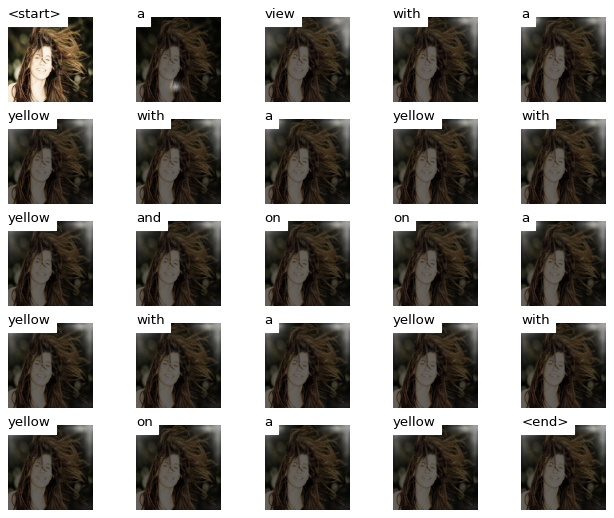

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:03<01:13,  3.89s/it]

Image file name: ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:04<00:37,  2.10s/it]

No caption could be generated for ../data/flickr_8k/Images/2316097768_ef662f444b.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:05<00:26,  1.54s/it]

No caption could be generated for ../data/flickr_8k/Images/2439384468_58934deab6.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:06<00:20,  1.26s/it]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:07<00:16,  1.11s/it]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:08<00:14,  1.02s/it]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:08<00:12,  1.04it/s]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:09<00:11,  1.07it/s]

No caption could be generated for ../data/flickr_8k/Images/2111360187_d2505437b7.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:10<00:10,  1.09it/s]

No caption could be generated for ../data/flickr_8k/Images/2271671533_7538ccd556.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:11<00:09,  1.07it/s]

No caption could be generated for ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:12<00:08,  1.09it/s]

No caption could be generated for ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg.


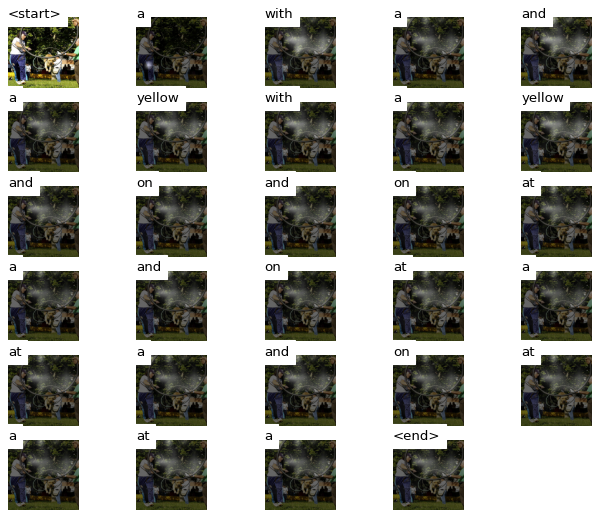

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:16<00:15,  1.93s/it]

Image file name: ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:17<00:11,  1.62s/it]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:18<00:08,  1.41s/it]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:19<00:06,  1.25s/it]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:20<00:04,  1.17s/it]

No caption could be generated for ../data/flickr_8k/Images/2337919839_df83827fa0.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:21<00:03,  1.12s/it]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:22<00:02,  1.09s/it]

No caption could be generated for ../data/flickr_8k/Images/23445819_3a458716c1.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:23<00:01,  1.08s/it]

No caption could be generated for ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:24<00:00,  1.23s/it]

No caption could be generated for ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg.


In [19]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

### 2000k, 0.2 filter

In [20]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_2000_0.2.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

In [21]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:12,  1.50it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:12,  1.50it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:11,  1.51it/s]

No caption could be generated for ../data/iaprtc12/images/20/20343.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:10,  1.51it/s]

No caption could be generated for ../data/iaprtc12/images/12/12761.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:03<00:09,  1.54it/s]

No caption could be generated for ../data/iaprtc12/images/22/22381.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:09,  1.54it/s]

No caption could be generated for ../data/iaprtc12/images/10/10821.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:08,  1.53it/s]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:05<00:07,  1.54it/s]

No caption could be generated for ../data/iaprtc12/images/17/17173.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.59it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:06<00:06,  1.58it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:07<00:05,  1.59it/s]

No caption could be generated for ../data/iaprtc12/images/11/11310.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:07<00:04,  1.60it/s]

No caption could be generated for ../data/iaprtc12/images/14/14183.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:08<00:04,  1.61it/s]

No caption could be generated for ../data/iaprtc12/images/10/10622.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.63it/s]

No caption could be generated for ../data/iaprtc12/images/13/13123.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:09<00:03,  1.62it/s]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:10<00:02,  1.65it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:10<00:01,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/11/11308.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:11<00:01,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/14/14016.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:11<00:00,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/21/21029.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:12<00:00,  1.61it/s]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [22]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:11,  1.69it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:10,  1.69it/s]

No caption could be generated for ../data/iaprtc12/images/39/39158.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/25/25053.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:09,  1.73it/s]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:02<00:08,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/32/32397.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:08,  1.74it/s]

No caption could be generated for ../data/iaprtc12/images/38/38937.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:07,  1.77it/s]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:06,  1.74it/s]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:05<00:05,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/30/30138.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:06<00:04,  1.77it/s]

No caption could be generated for ../data/iaprtc12/images/40/40202.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:03,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/35/35895.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:09<00:01,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.76it/s]

No caption could be generated for ../data/iaprtc12/images/35/35858.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:10<00:00,  1.78it/s]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.75it/s]

No caption could be generated for ../data/iaprtc12/images/39/39239.jpg.


In [23]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:10,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2316097768_ef662f444b.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.78it/s]

No caption could be generated for ../data/flickr_8k/Images/2439384468_58934deab6.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:09,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:02<00:08,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:07,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:07,  1.74it/s]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:06,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2111360187_d2505437b7.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.74it/s]

No caption could be generated for ../data/flickr_8k/Images/2271671533_7538ccd556.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:05<00:05,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:06<00:04,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:04,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.74it/s]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.77it/s]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.77it/s]

No caption could be generated for ../data/flickr_8k/Images/2337919839_df83827fa0.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:09<00:01,  1.76it/s]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/23445819_3a458716c1.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:10<00:00,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg.


### 2000k, no filter

In [24]:
finetuned_path = os.path.join(saved_root_dir, 'checkpoint_clef_2000_1.0.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.88it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:09,  1.82it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


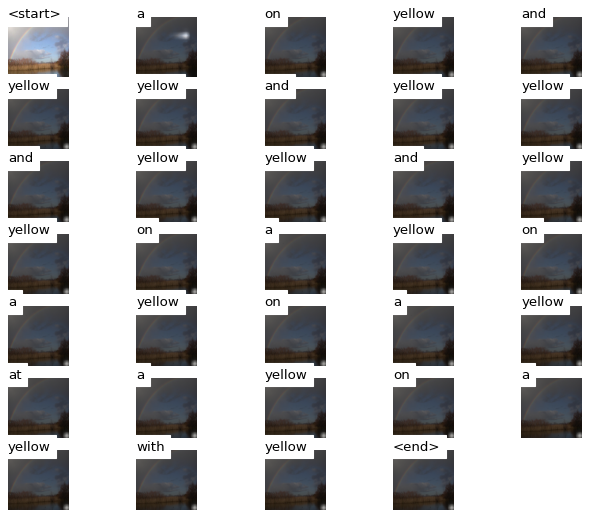

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:05<00:40,  2.38s/it]

Image file name: ../data/iaprtc12/images/20/20343.jpg


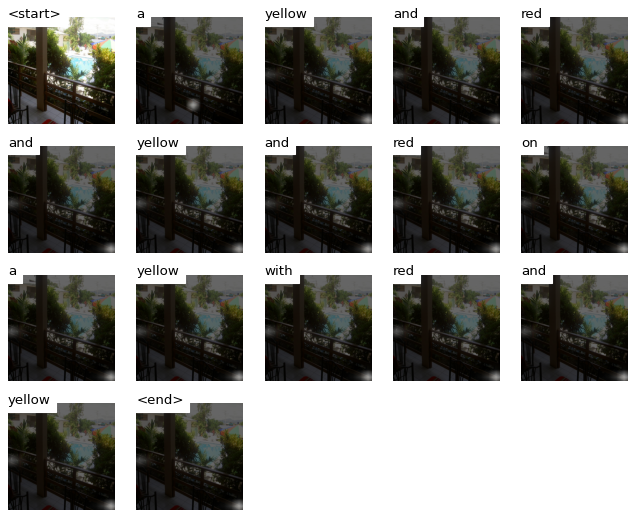

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:08<00:37,  2.37s/it]

Image file name: ../data/iaprtc12/images/12/12761.jpg


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:08<00:26,  1.78s/it]

No caption could be generated for ../data/iaprtc12/images/22/22381.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:09<00:20,  1.45s/it]

No caption could be generated for ../data/iaprtc12/images/10/10821.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:10<00:15,  1.22s/it]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:11<00:12,  1.08s/it]

No caption could be generated for ../data/iaprtc12/images/17/17173.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:11<00:10,  1.08it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:12<00:08,  1.15it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:13<00:07,  1.21it/s]

No caption could be generated for ../data/iaprtc12/images/11/11310.jpg.


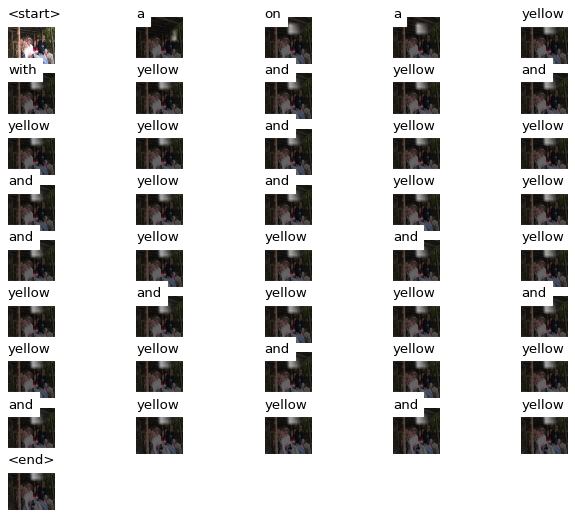

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:17<00:15,  1.99s/it]

Image file name: ../data/iaprtc12/images/14/14183.jpg


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:18<00:11,  1.58s/it]

No caption could be generated for ../data/iaprtc12/images/10/10622.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:19<00:07,  1.29s/it]

No caption could be generated for ../data/iaprtc12/images/13/13123.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:19<00:05,  1.09s/it]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:20<00:03,  1.04it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:21<00:02,  1.12it/s]

No caption could be generated for ../data/iaprtc12/images/11/11308.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:21<00:01,  1.20it/s]

No caption could be generated for ../data/iaprtc12/images/14/14016.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:22<00:00,  1.27it/s]

No caption could be generated for ../data/iaprtc12/images/21/21029.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:23<00:00,  1.16s/it]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [25]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:11,  1.61it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


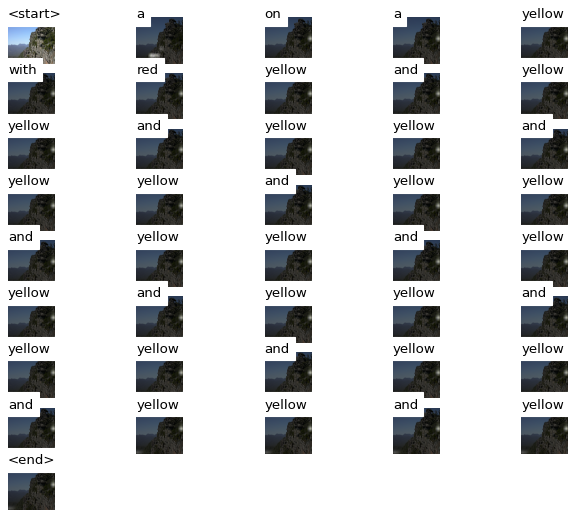

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:05<00:52,  2.94s/it]

Image file name: ../data/iaprtc12/images/39/39158.jpg


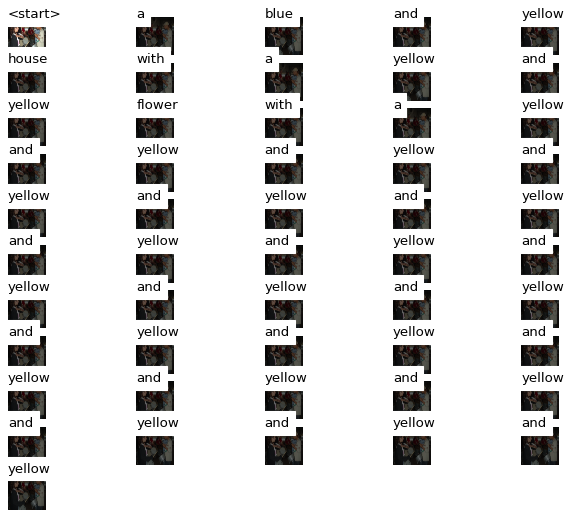

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:10<01:06,  3.90s/it]

Image file name: ../data/iaprtc12/images/25/25053.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:10<00:41,  2.62s/it]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


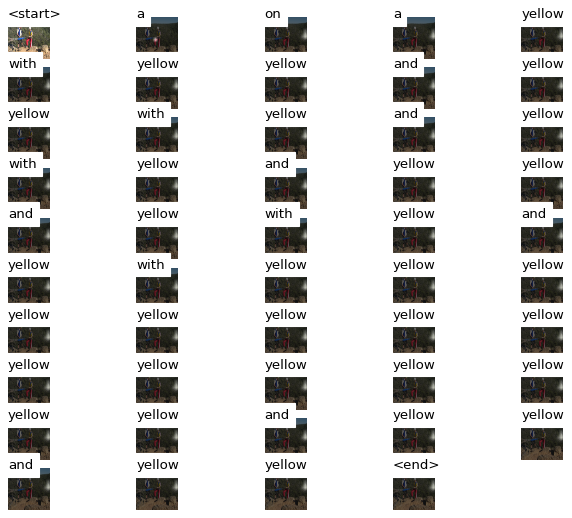

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:15<00:50,  3.39s/it]

Image file name: ../data/iaprtc12/images/32/32397.jpg


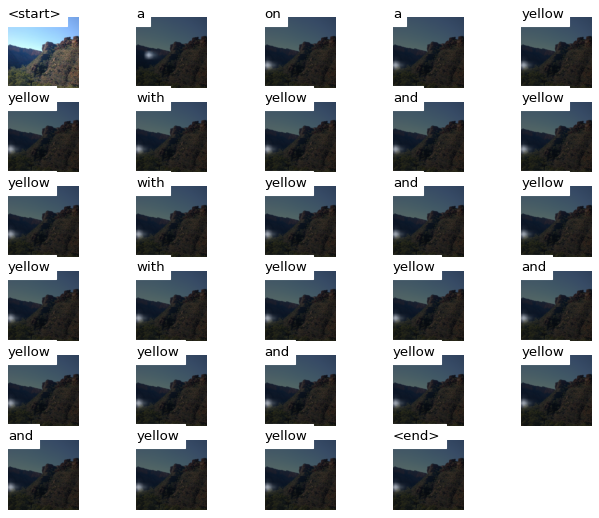

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:19<00:51,  3.67s/it]

Image file name: ../data/iaprtc12/images/38/38937.jpg


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:20<00:34,  2.65s/it]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:20<00:23,  1.98s/it]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:21<00:16,  1.53s/it]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:22<00:12,  1.23s/it]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:22<00:09,  1.02s/it]

No caption could be generated for ../data/iaprtc12/images/30/30138.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:23<00:07,  1.14it/s]

No caption could be generated for ../data/iaprtc12/images/40/40202.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:23<00:05,  1.29it/s]

No caption could be generated for ../data/iaprtc12/images/35/35895.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:24<00:04,  1.39it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:24<00:03,  1.46it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


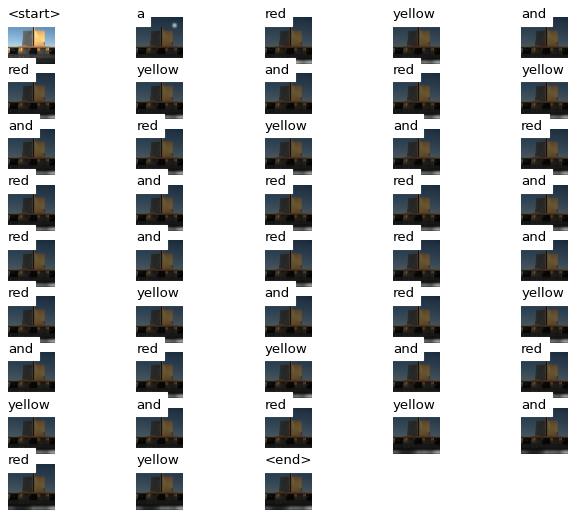

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:29<00:07,  1.93s/it]

Image file name: ../data/iaprtc12/images/38/38081.jpg


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:30<00:04,  1.51s/it]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


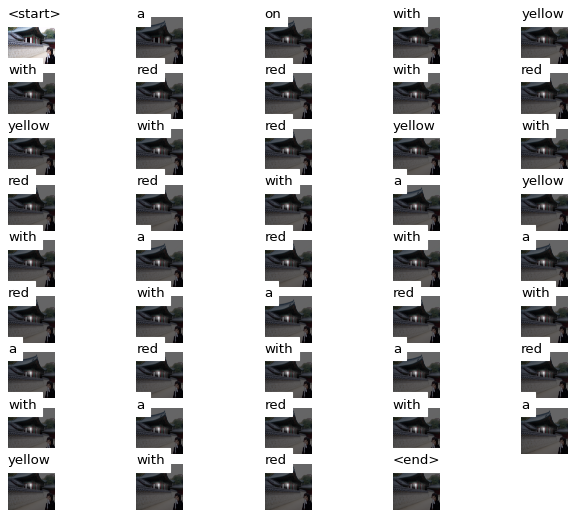

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:34<00:04,  2.49s/it]

Image file name: ../data/iaprtc12/images/35/35858.jpg


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:35<00:01,  1.96s/it]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


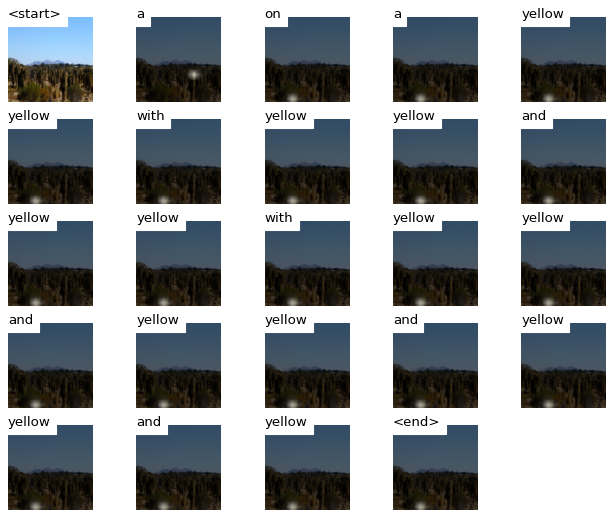

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:39<00:00,  1.96s/it]

Image file name: ../data/iaprtc12/images/39/39239.jpg


In [26]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.79it/s]

No caption could be generated for ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:10,  1.79it/s]

No caption could be generated for ../data/flickr_8k/Images/2316097768_ef662f444b.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.79it/s]

No caption could be generated for ../data/flickr_8k/Images/2439384468_58934deab6.jpg.


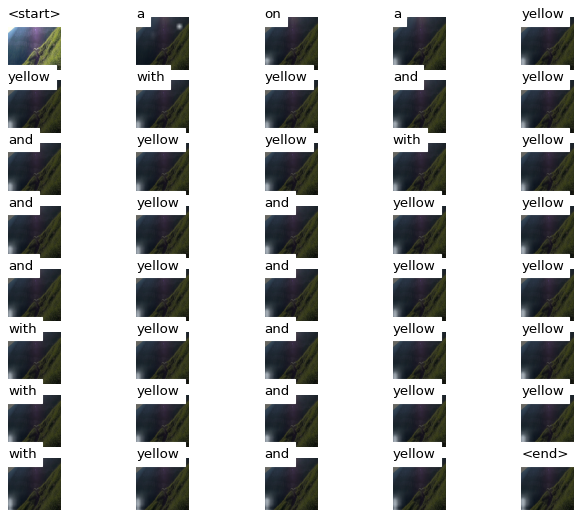

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:06<00:34,  2.14s/it]

Image file name: ../data/flickr_8k/Images/2112921744_92bf706805.jpg


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:06<00:24,  1.61s/it]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:07<00:17,  1.28s/it]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:08<00:13,  1.07s/it]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:08<00:11,  1.05it/s]

No caption could be generated for ../data/flickr_8k/Images/2111360187_d2505437b7.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:09<00:09,  1.17it/s]

No caption could be generated for ../data/flickr_8k/Images/2271671533_7538ccd556.jpg.


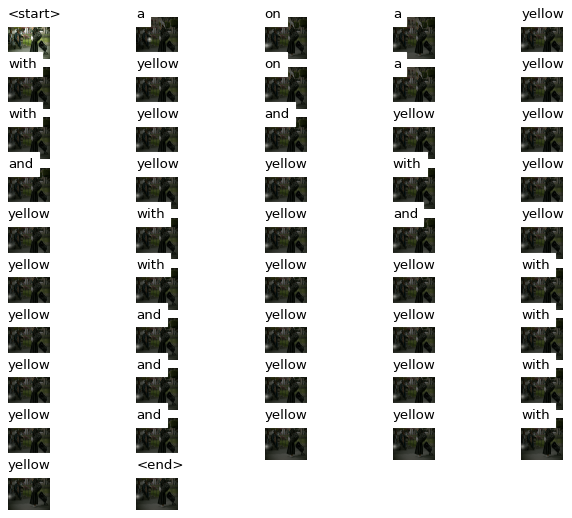

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:14<00:20,  2.08s/it]

Image file name: ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg


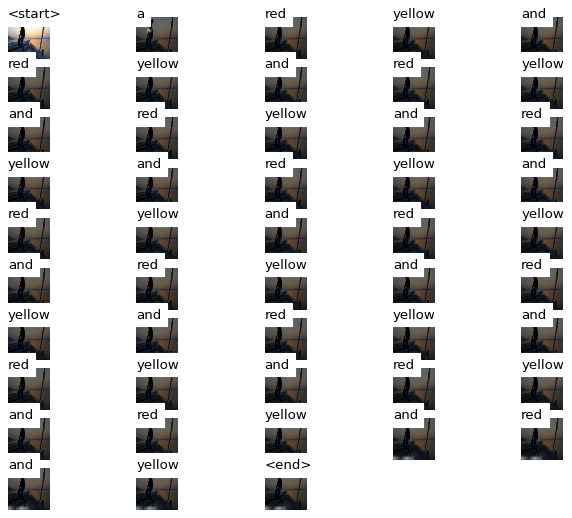

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:19<00:26,  2.93s/it]

Image file name: ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:19<00:17,  2.21s/it]

No caption could be generated for ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:20<00:12,  1.72s/it]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:20<00:08,  1.38s/it]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:21<00:05,  1.14s/it]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:22<00:03,  1.02it/s]

No caption could be generated for ../data/flickr_8k/Images/2337919839_df83827fa0.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:22<00:02,  1.15it/s]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:23<00:01,  1.25it/s]

No caption could be generated for ../data/flickr_8k/Images/23445819_3a458716c1.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:24<00:00,  1.35it/s]

No caption could be generated for ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg.


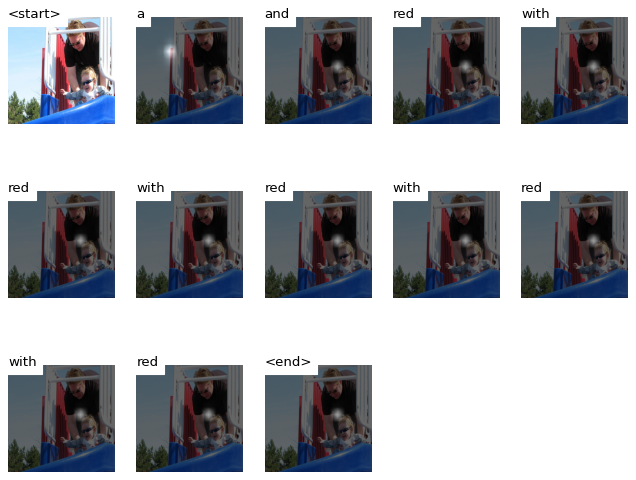

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:26<00:00,  1.31s/it]

Image file name: ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg


In [27]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

### 5000k, 0.1 filter

In [28]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_5000_0.1.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

In [29]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:11,  1.60it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:11,  1.60it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:10,  1.57it/s]

No caption could be generated for ../data/iaprtc12/images/20/20343.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:10,  1.55it/s]

No caption could be generated for ../data/iaprtc12/images/12/12761.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:03<00:09,  1.55it/s]

No caption could be generated for ../data/iaprtc12/images/22/22381.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:08,  1.57it/s]

No caption could be generated for ../data/iaprtc12/images/10/10821.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:08,  1.54it/s]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:05<00:07,  1.51it/s]

No caption could be generated for ../data/iaprtc12/images/17/17173.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:06<00:07,  1.41it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:06<00:06,  1.49it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:07<00:05,  1.55it/s]

No caption could be generated for ../data/iaprtc12/images/11/11310.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:07<00:04,  1.60it/s]

No caption could be generated for ../data/iaprtc12/images/14/14183.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:08<00:04,  1.63it/s]

No caption could be generated for ../data/iaprtc12/images/10/10622.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.65it/s]

No caption could be generated for ../data/iaprtc12/images/13/13123.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:09<00:02,  1.68it/s]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:10<00:02,  1.65it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:10<00:01,  1.65it/s]

No caption could be generated for ../data/iaprtc12/images/11/11308.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:11<00:01,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/14/14016.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:11<00:00,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/21/21029.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:12<00:00,  1.60it/s]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [30]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:12,  1.57it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:11,  1.61it/s]

No caption could be generated for ../data/iaprtc12/images/39/39158.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:10,  1.63it/s]

No caption could be generated for ../data/iaprtc12/images/25/25053.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:09,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:03<00:08,  1.67it/s]

No caption could be generated for ../data/iaprtc12/images/32/32397.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:08,  1.64it/s]

No caption could be generated for ../data/iaprtc12/images/38/38937.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:07,  1.64it/s]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:07,  1.65it/s]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.63it/s]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:06<00:06,  1.66it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.69it/s]

No caption could be generated for ../data/iaprtc12/images/30/30138.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:07<00:04,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/40/40202.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:04,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/35/35895.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.71it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:10<00:01,  1.69it/s]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.70it/s]

No caption could be generated for ../data/iaprtc12/images/35/35858.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:11<00:00,  1.72it/s]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.68it/s]

No caption could be generated for ../data/iaprtc12/images/39/39239.jpg.


In [31]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:11,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg.


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:10,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2316097768_ef662f444b.jpg.


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:01<00:09,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/2439384468_58934deab6.jpg.


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:09,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:02<00:08,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:03<00:08,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:04<00:07,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:04<00:06,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/2111360187_d2505437b7.jpg.


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:05<00:06,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/2271671533_7538ccd556.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:05<00:05,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg.


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:06<00:05,  1.76it/s]

No caption could be generated for ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg.


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:06<00:04,  1.77it/s]

No caption could be generated for ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg.


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:07<00:03,  1.76it/s]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:08<00:03,  1.76it/s]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:08<00:02,  1.75it/s]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:09<00:02,  1.76it/s]

No caption could be generated for ../data/flickr_8k/Images/2337919839_df83827fa0.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:09<00:01,  1.74it/s]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:10<00:01,  1.72it/s]

No caption could be generated for ../data/flickr_8k/Images/23445819_3a458716c1.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:10<00:00,  1.69it/s]

No caption could be generated for ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg.


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:11<00:00,  1.73it/s]

No caption could be generated for ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg.


### 5000k, 0.15 filter

In [32]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_5000_0.15.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.83it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


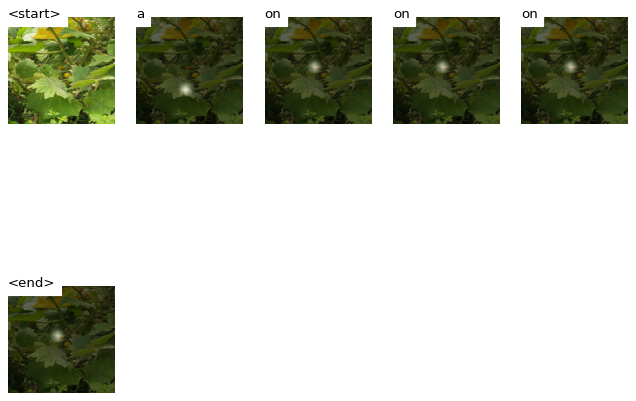

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:14,  1.26it/s]

Image file name: ../data/iaprtc12/images/20/20144.jpg


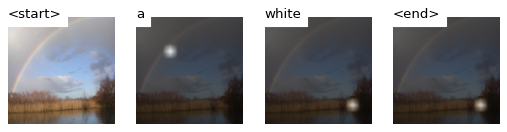

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:12,  1.33it/s]

Image file name: ../data/iaprtc12/images/20/20343.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:10,  1.47it/s]

No caption could be generated for ../data/iaprtc12/images/12/12761.jpg.


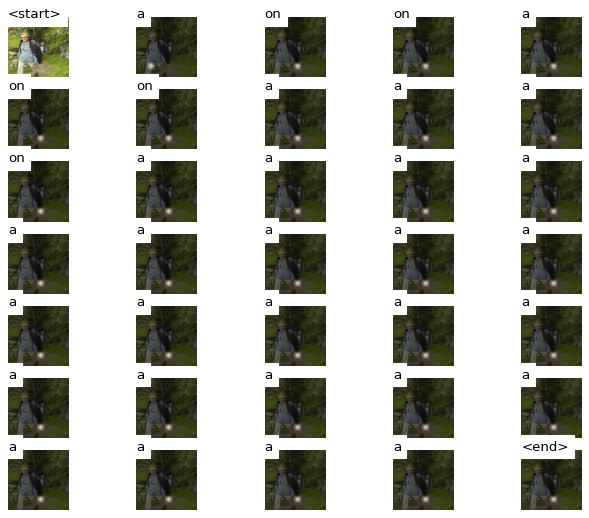

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:07<00:30,  2.04s/it]

Image file name: ../data/iaprtc12/images/22/22381.jpg


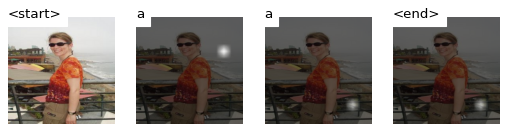

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:08<00:23,  1.65s/it]

Image file name: ../data/iaprtc12/images/10/10821.jpg


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:08<00:16,  1.29s/it]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


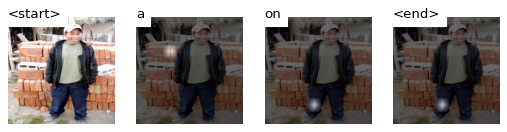

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:09<00:13,  1.10s/it]

Image file name: ../data/iaprtc12/images/17/17173.jpg


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:09<00:10,  1.08it/s]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:10<00:08,  1.23it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


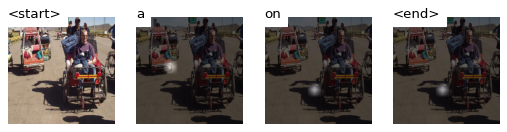

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:11<00:07,  1.28it/s]

Image file name: ../data/iaprtc12/images/11/11310.jpg


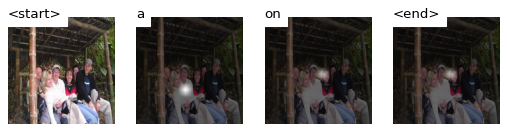

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:11<00:06,  1.30it/s]

Image file name: ../data/iaprtc12/images/14/14183.jpg


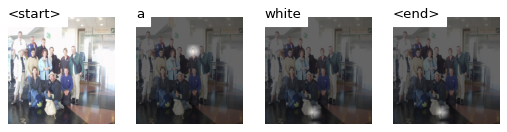

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:12<00:05,  1.33it/s]

Image file name: ../data/iaprtc12/images/10/10622.jpg


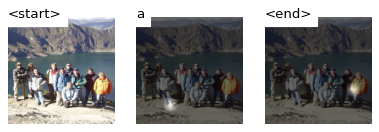

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:13<00:04,  1.45it/s]

Image file name: ../data/iaprtc12/images/13/13123.jpg


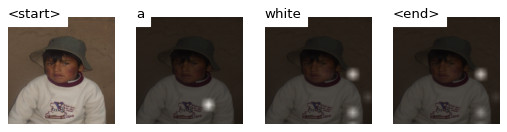

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:13<00:03,  1.45it/s]

Image file name: ../data/iaprtc12/images/19/19181.jpg


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:14<00:02,  1.54it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


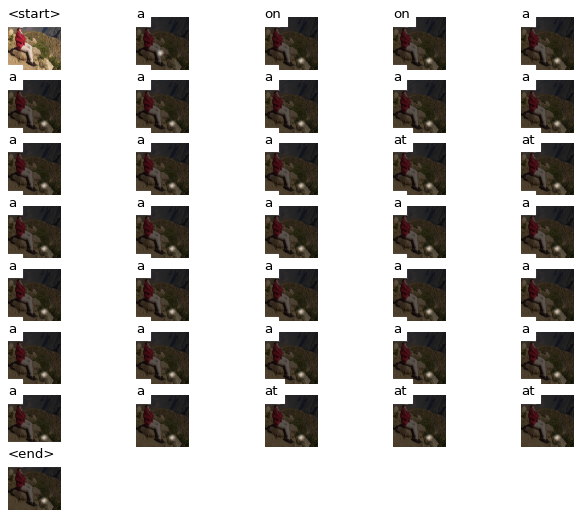

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:18<00:05,  1.73s/it]

Image file name: ../data/iaprtc12/images/11/11308.jpg


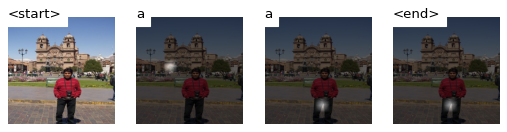

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:19<00:02,  1.42s/it]

Image file name: ../data/iaprtc12/images/14/14016.jpg


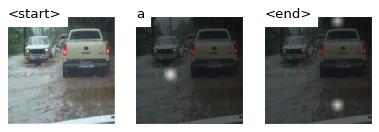

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:19<00:01,  1.16s/it]

Image file name: ../data/iaprtc12/images/21/21029.jpg


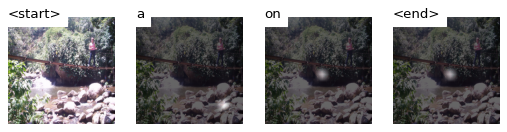

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:20<00:00,  1.03s/it]

Image file name: ../data/iaprtc12/images/18/18355.jpg


In [33]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

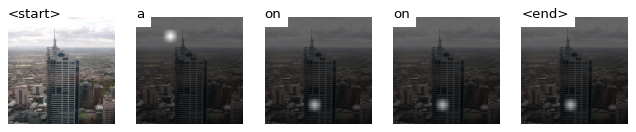

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:15,  1.23it/s]

Image file name: ../data/iaprtc12/images/40/40416.jpg


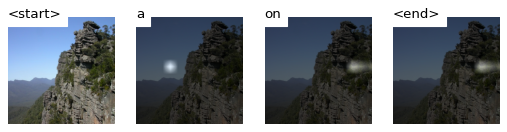

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:13,  1.36it/s]

Image file name: ../data/iaprtc12/images/39/39158.jpg


Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:11,  1.45it/s]

No caption could be generated for ../data/iaprtc12/images/25/25053.jpg.


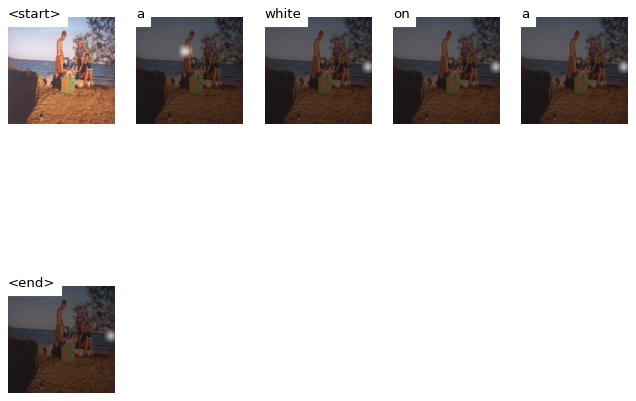

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:03<00:13,  1.17it/s]

Image file name: ../data/iaprtc12/images/30/30620.jpg


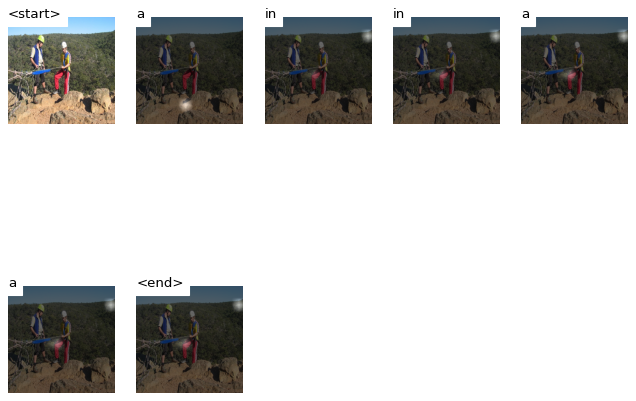

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:04<00:15,  1.01s/it]

Image file name: ../data/iaprtc12/images/32/32397.jpg


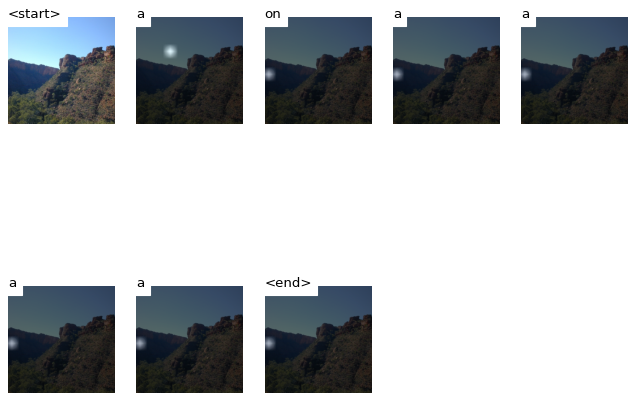

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:06<00:16,  1.18s/it]

Image file name: ../data/iaprtc12/images/38/38937.jpg


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:06<00:13,  1.00s/it]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:07<00:10,  1.09it/s]

No caption could be generated for ../data/iaprtc12/images/40/40120.jpg.


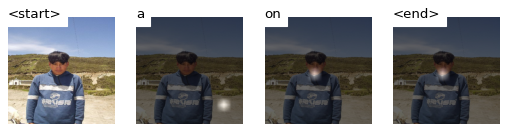

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:08<00:09,  1.18it/s]

Image file name: ../data/iaprtc12/images/23/23588.jpg


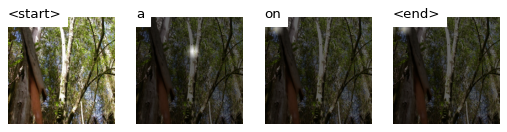

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:09<00:09,  1.10it/s]

Image file name: ../data/iaprtc12/images/39/39472.jpg


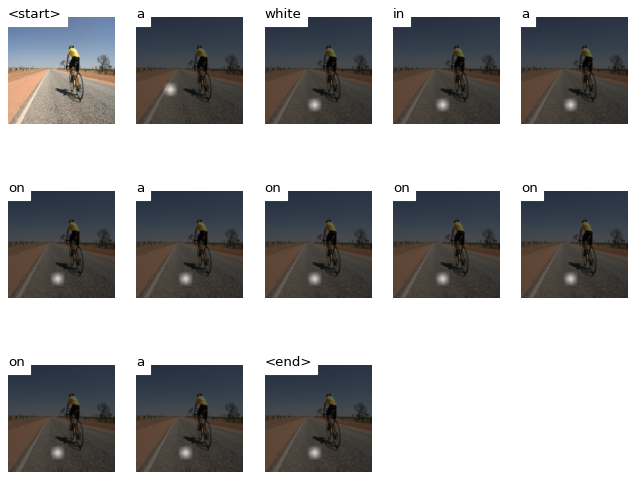

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:11<00:11,  1.32s/it]

Image file name: ../data/iaprtc12/images/30/30138.jpg


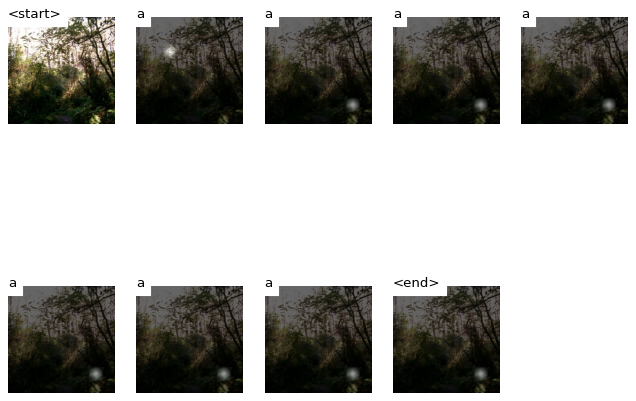

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:12<00:10,  1.33s/it]

Image file name: ../data/iaprtc12/images/40/40202.jpg


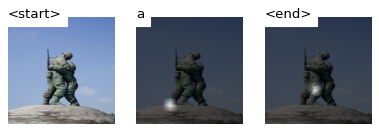

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:13<00:08,  1.17s/it]

Image file name: ../data/iaprtc12/images/35/35895.jpg


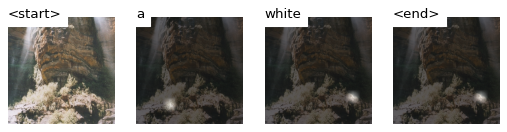

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:14<00:06,  1.05s/it]

Image file name: ../data/iaprtc12/images/32/32663.jpg


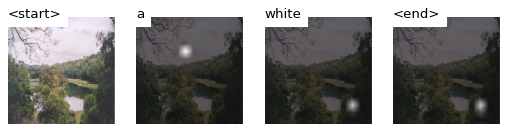

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:15<00:05,  1.03s/it]

Image file name: ../data/iaprtc12/images/30/30705.jpg


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:15<00:03,  1.12it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:16<00:02,  1.25it/s]

No caption could be generated for ../data/iaprtc12/images/31/31571.jpg.


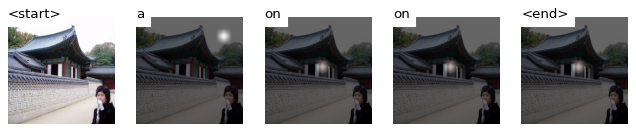

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:17<00:01,  1.23it/s]

Image file name: ../data/iaprtc12/images/35/35858.jpg


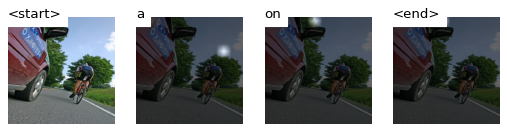

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:18<00:00,  1.15it/s]

Image file name: ../data/iaprtc12/images/37/37836.jpg


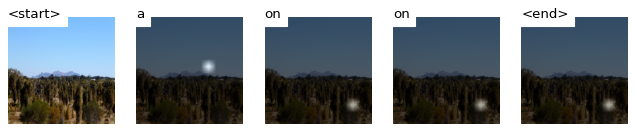

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:19<00:00,  1.04it/s]

Image file name: ../data/iaprtc12/images/39/39239.jpg


In [34]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

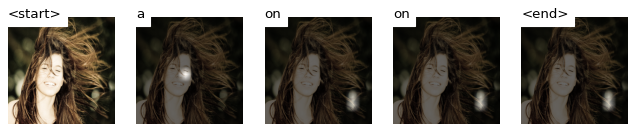

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:17,  1.06it/s]

Image file name: ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg


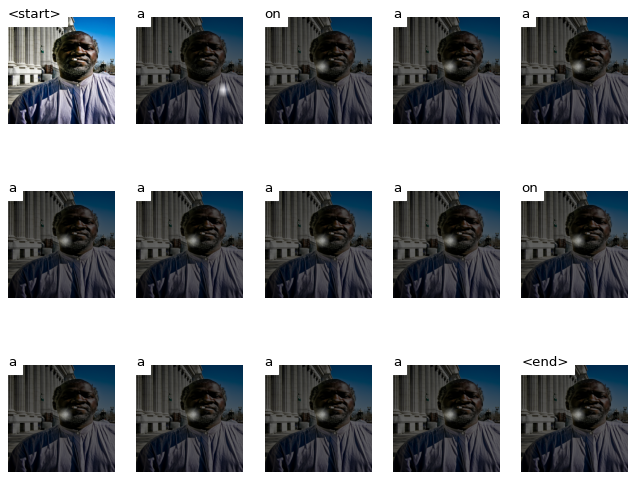

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:03<00:32,  1.80s/it]

Image file name: ../data/flickr_8k/Images/2316097768_ef662f444b.jpg


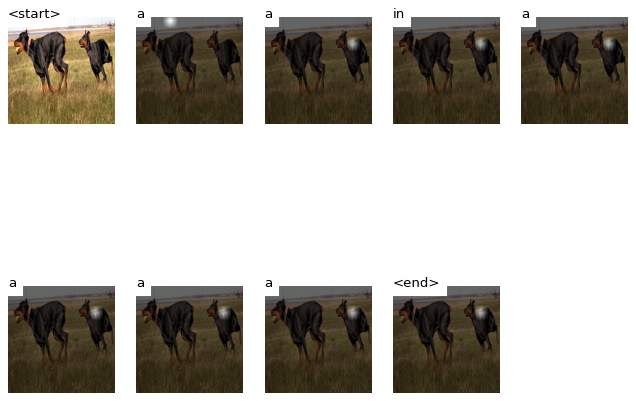

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:04<00:27,  1.65s/it]

Image file name: ../data/flickr_8k/Images/2439384468_58934deab6.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:05<00:19,  1.22s/it]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:05<00:14,  1.02it/s]

No caption could be generated for ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg.


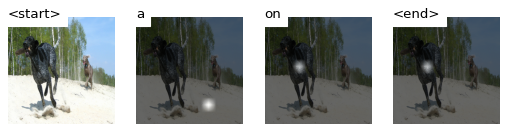

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:06<00:12,  1.13it/s]

Image file name: ../data/flickr_8k/Images/2434006663_207a284cec.jpg


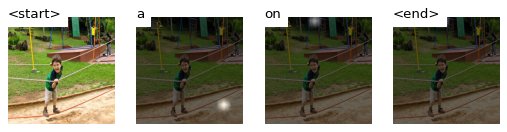

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:07<00:10,  1.20it/s]

Image file name: ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg


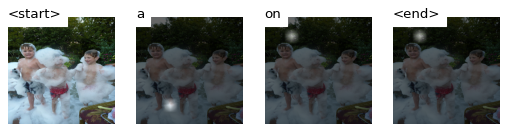

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:08<00:09,  1.28it/s]

Image file name: ../data/flickr_8k/Images/2111360187_d2505437b7.jpg


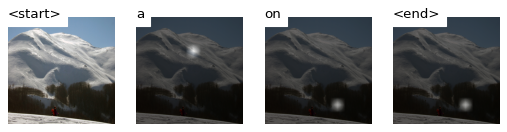

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:08<00:08,  1.28it/s]

Image file name: ../data/flickr_8k/Images/2271671533_7538ccd556.jpg


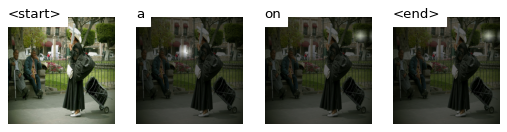

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:09<00:07,  1.28it/s]

Image file name: ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg


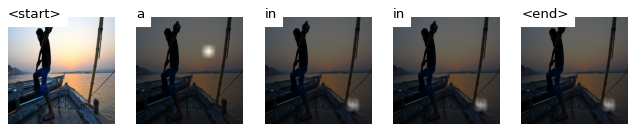

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:10<00:07,  1.25it/s]

Image file name: ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg


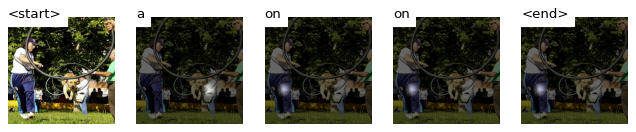

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:11<00:06,  1.21it/s]

Image file name: ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg


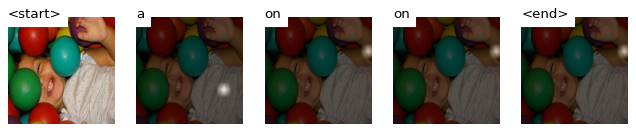

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:12<00:06,  1.01it/s]

Image file name: ../data/flickr_8k/Images/2279980395_989d48ae72.jpg


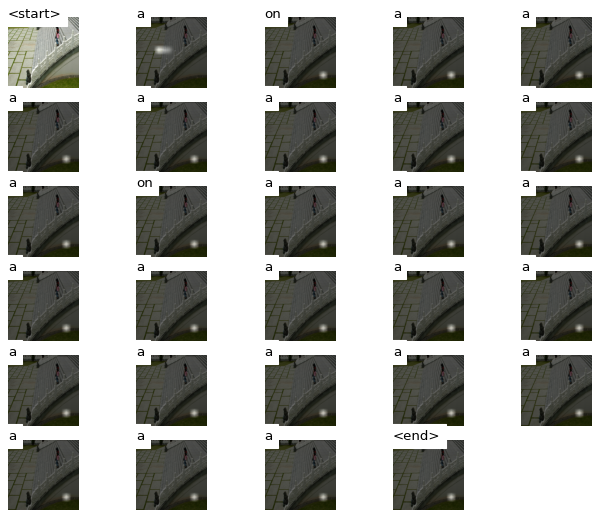

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:16<00:11,  1.93s/it]

Image file name: ../data/flickr_8k/Images/2393971707_bce01ae754.jpg


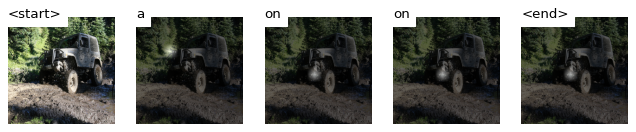

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:17<00:07,  1.59s/it]

Image file name: ../data/flickr_8k/Images/211277478_7d43aaee09.jpg


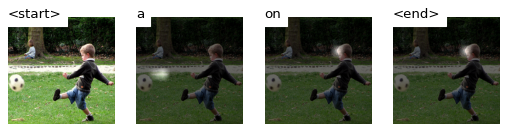

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:18<00:05,  1.36s/it]

Image file name: ../data/flickr_8k/Images/2337919839_df83827fa0.jpg


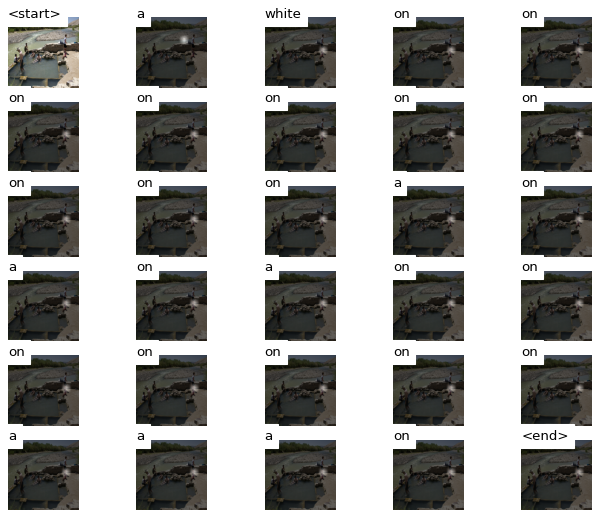

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:22<00:06,  2.28s/it]

Image file name: ../data/flickr_8k/Images/2447035752_415f4bb152.jpg


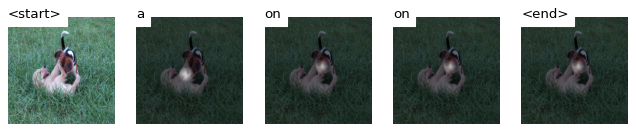

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:23<00:03,  1.90s/it]

Image file name: ../data/flickr_8k/Images/23445819_3a458716c1.jpg


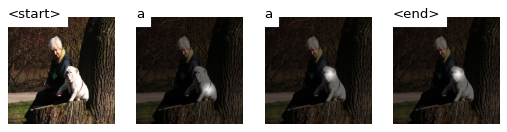

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:24<00:01,  1.55s/it]

Image file name: ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg


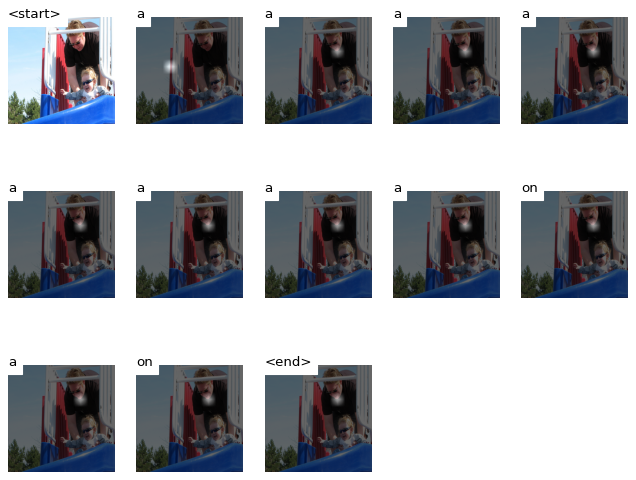

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:26<00:00,  1.34s/it]

Image file name: ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg


In [35]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

### 5000k, 0.2 filter

In [36]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_5000_0.2.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

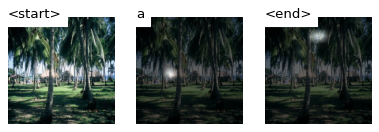

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:14,  1.28it/s]

Image file name: ../data/iaprtc12/images/15/15551.jpg


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:13,  1.37it/s]

No caption could be generated for ../data/iaprtc12/images/20/20144.jpg.


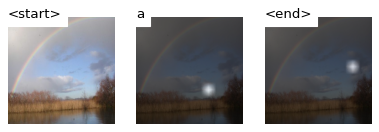

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:13,  1.26it/s]

Image file name: ../data/iaprtc12/images/20/20343.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:03<00:12,  1.30it/s]

No caption could be generated for ../data/iaprtc12/images/12/12761.jpg.


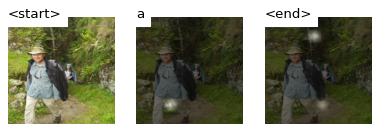

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:04<00:12,  1.20it/s]

Image file name: ../data/iaprtc12/images/22/22381.jpg


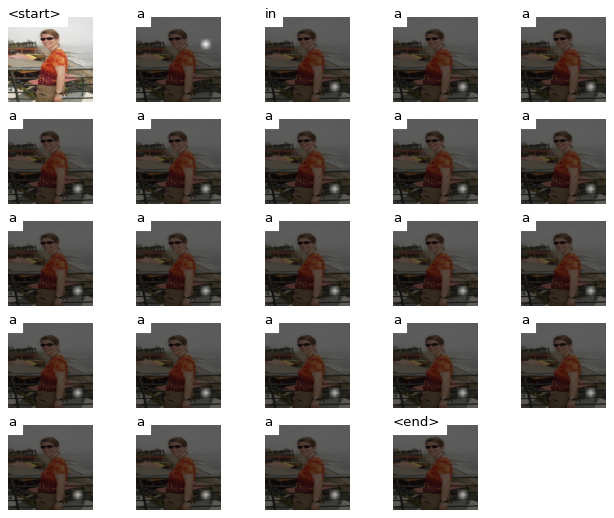

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:07<00:25,  1.86s/it]

Image file name: ../data/iaprtc12/images/10/10821.jpg


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:08<00:18,  1.45s/it]

No caption could be generated for ../data/iaprtc12/images/18/18448.jpg.


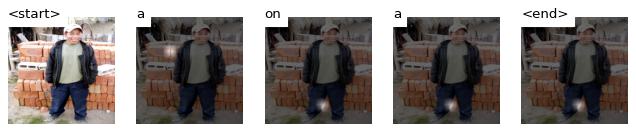

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:09<00:15,  1.26s/it]

Image file name: ../data/iaprtc12/images/17/17173.jpg


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:09<00:11,  1.06s/it]

No caption could be generated for ../data/iaprtc12/images/13/13152.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:10<00:09,  1.10it/s]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


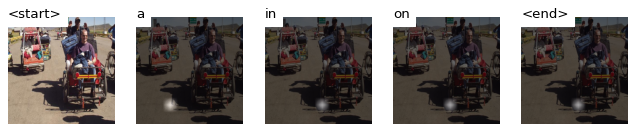

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:11<00:08,  1.12it/s]

Image file name: ../data/iaprtc12/images/11/11310.jpg


Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:12<00:06,  1.23it/s]

No caption could be generated for ../data/iaprtc12/images/14/14183.jpg.


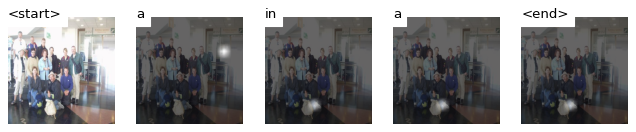

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:13<00:06,  1.07it/s]

Image file name: ../data/iaprtc12/images/10/10622.jpg


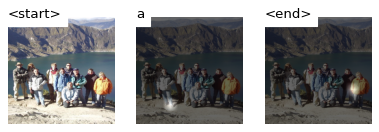

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:13<00:04,  1.22it/s]

Image file name: ../data/iaprtc12/images/13/13123.jpg


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:14<00:03,  1.30it/s]

No caption could be generated for ../data/iaprtc12/images/19/19181.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:15<00:02,  1.40it/s]

No caption could be generated for ../data/iaprtc12/images/16/16920.jpg.


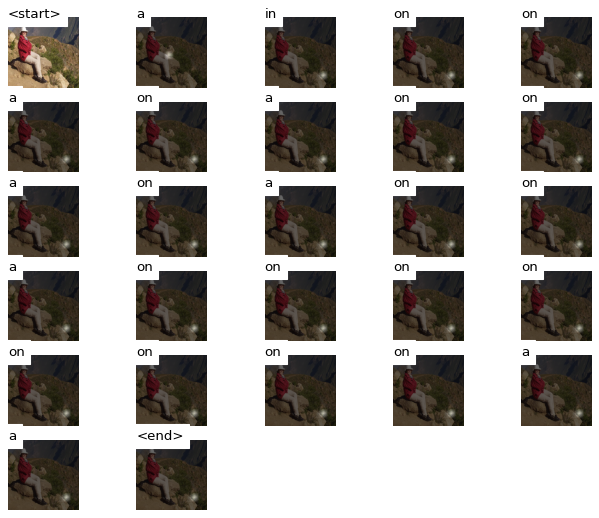

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:19<00:05,  1.74s/it]

Image file name: ../data/iaprtc12/images/11/11308.jpg


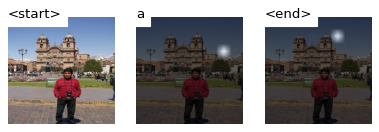

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:20<00:02,  1.49s/it]

Image file name: ../data/iaprtc12/images/14/14016.jpg


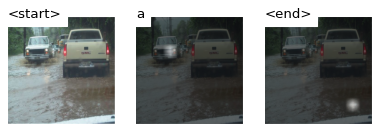

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:20<00:01,  1.31s/it]

Image file name: ../data/iaprtc12/images/21/21029.jpg


Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:21<00:00,  1.08s/it]

No caption could be generated for ../data/iaprtc12/images/18/18355.jpg.


In [37]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

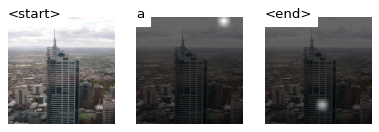

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:12,  1.58it/s]

Image file name: ../data/iaprtc12/images/40/40416.jpg


Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:11,  1.62it/s]

No caption could be generated for ../data/iaprtc12/images/39/39158.jpg.


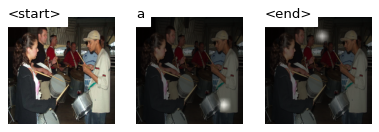

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:12,  1.41it/s]

Image file name: ../data/iaprtc12/images/25/25053.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:10,  1.50it/s]

No caption could be generated for ../data/iaprtc12/images/30/30620.jpg.


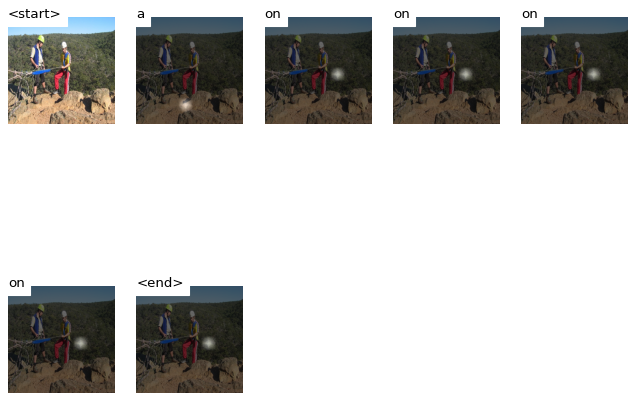

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:03<00:13,  1.11it/s]

Image file name: ../data/iaprtc12/images/32/32397.jpg


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:04<00:11,  1.27it/s]

No caption could be generated for ../data/iaprtc12/images/38/38937.jpg.


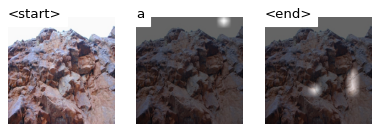

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:05<00:10,  1.23it/s]

Image file name: ../data/iaprtc12/images/39/39005.jpg


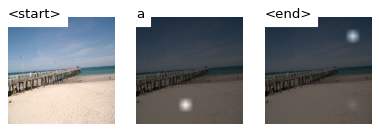

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:06<00:10,  1.19it/s]

Image file name: ../data/iaprtc12/images/40/40120.jpg


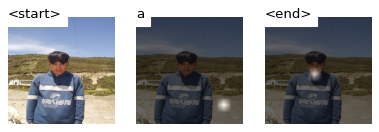

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:06<00:08,  1.28it/s]

Image file name: ../data/iaprtc12/images/23/23588.jpg


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:07<00:07,  1.39it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


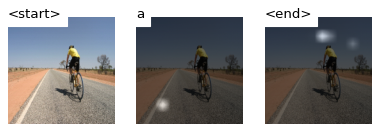

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:08<00:06,  1.30it/s]

Image file name: ../data/iaprtc12/images/30/30138.jpg


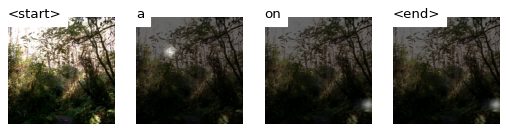

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:09<00:05,  1.34it/s]

Image file name: ../data/iaprtc12/images/40/40202.jpg


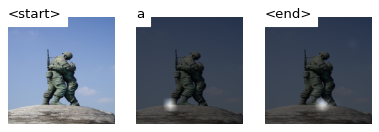

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:09<00:05,  1.27it/s]

Image file name: ../data/iaprtc12/images/35/35895.jpg


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:10<00:04,  1.39it/s]

No caption could be generated for ../data/iaprtc12/images/32/32663.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:11<00:03,  1.48it/s]

No caption could be generated for ../data/iaprtc12/images/30/30705.jpg.


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:11<00:02,  1.55it/s]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


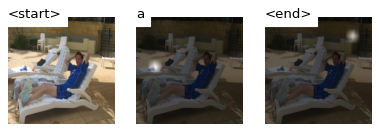

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:12<00:02,  1.31it/s]

Image file name: ../data/iaprtc12/images/31/31571.jpg


Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:13<00:01,  1.43it/s]

No caption could be generated for ../data/iaprtc12/images/35/35858.jpg.


Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:13<00:00,  1.50it/s]

No caption could be generated for ../data/iaprtc12/images/37/37836.jpg.


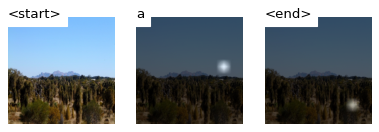

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:14<00:00,  1.36it/s]

Image file name: ../data/iaprtc12/images/39/39239.jpg


In [38]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.80it/s]

No caption could be generated for ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg.


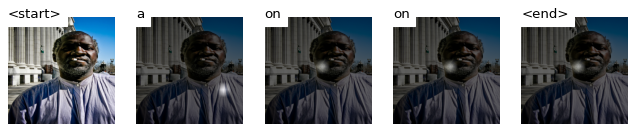

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:13,  1.36it/s]

Image file name: ../data/flickr_8k/Images/2316097768_ef662f444b.jpg


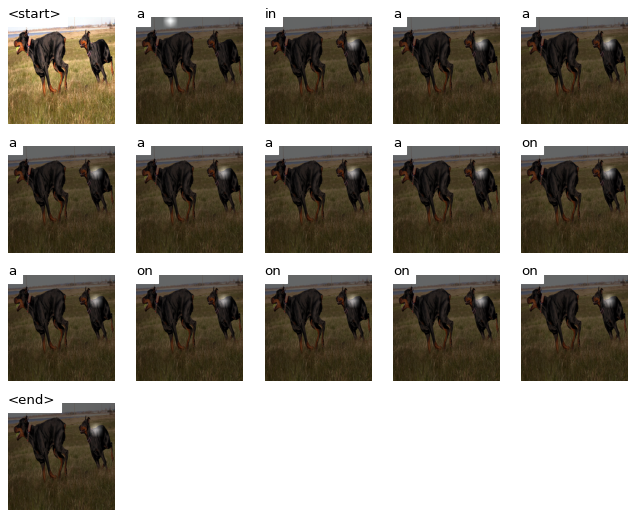

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:03<00:24,  1.43s/it]

Image file name: ../data/flickr_8k/Images/2439384468_58934deab6.jpg


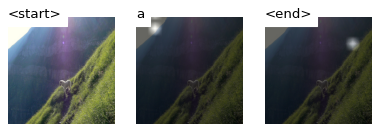

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:04<00:19,  1.21s/it]

Image file name: ../data/flickr_8k/Images/2112921744_92bf706805.jpg


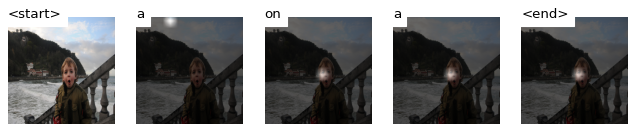

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:05<00:15,  1.07s/it]

Image file name: ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg


Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:05<00:12,  1.12it/s]

No caption could be generated for ../data/flickr_8k/Images/2434006663_207a284cec.jpg.


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:06<00:10,  1.28it/s]

No caption could be generated for ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg.


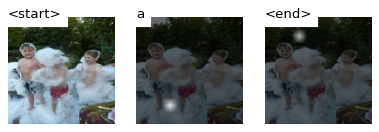

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:07<00:08,  1.39it/s]

Image file name: ../data/flickr_8k/Images/2111360187_d2505437b7.jpg


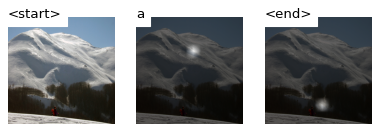

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:07<00:08,  1.32it/s]

Image file name: ../data/flickr_8k/Images/2271671533_7538ccd556.jpg


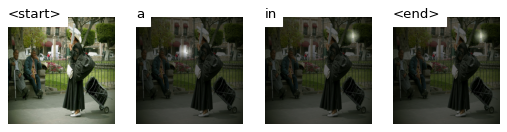

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:08<00:07,  1.36it/s]

Image file name: ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg


Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:09<00:06,  1.45it/s]

No caption could be generated for ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg.


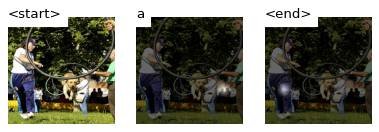

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:09<00:05,  1.37it/s]

Image file name: ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:10<00:04,  1.44it/s]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:11<00:03,  1.51it/s]

No caption could be generated for ../data/flickr_8k/Images/2393971707_bce01ae754.jpg.


Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:11<00:03,  1.54it/s]

No caption could be generated for ../data/flickr_8k/Images/211277478_7d43aaee09.jpg.


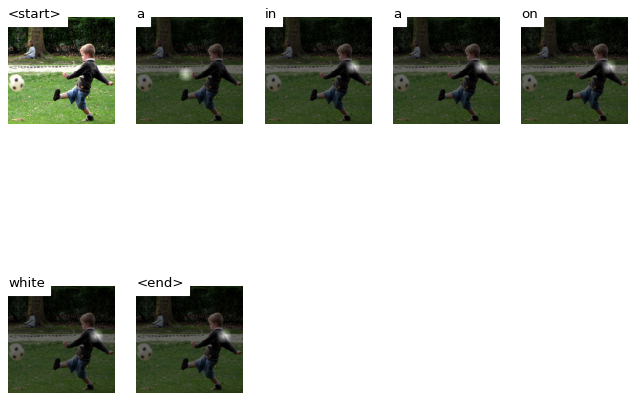

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:13<00:03,  1.07it/s]

Image file name: ../data/flickr_8k/Images/2337919839_df83827fa0.jpg


Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:13<00:02,  1.21it/s]

No caption could be generated for ../data/flickr_8k/Images/2447035752_415f4bb152.jpg.


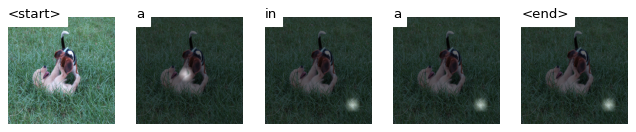

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:15<00:01,  1.11it/s]

Image file name: ../data/flickr_8k/Images/23445819_3a458716c1.jpg


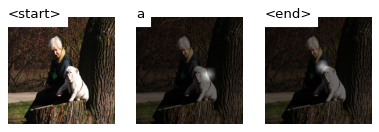

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:15<00:00,  1.25it/s]

Image file name: ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg


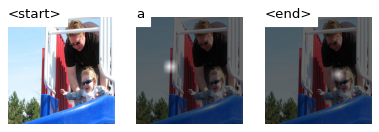

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:16<00:00,  1.21it/s]

Image file name: ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg


In [39]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

### 5000k, no filter

In [40]:
finetuned_path = os.path.join(saved_root_dir, 'BEST_checkpoint_clef_5000_1.0.pth.tar')
tester = CaptionTester(finetuned_path, word_map_path, device, START_TOKEN, END_TOKEN, UNKNOWN_TOKEN)

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:12,  1.58it/s]

No caption could be generated for ../data/iaprtc12/images/15/15551.jpg.


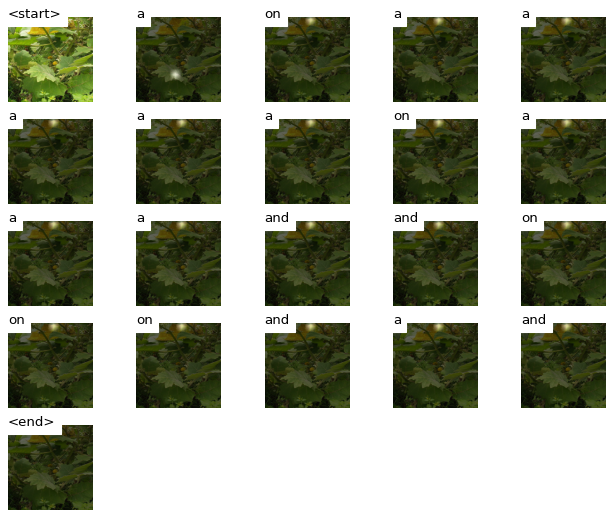

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:03<00:37,  2.10s/it]

Image file name: ../data/iaprtc12/images/20/20144.jpg


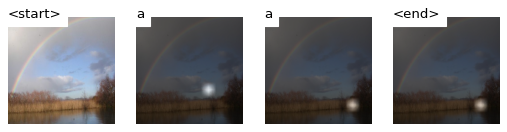

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:04<00:24,  1.47s/it]

Image file name: ../data/iaprtc12/images/20/20343.jpg


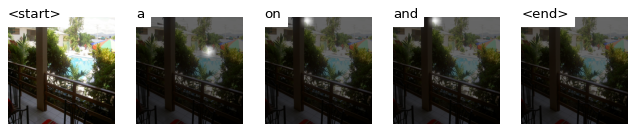

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:05<00:19,  1.23s/it]

Image file name: ../data/iaprtc12/images/12/12761.jpg


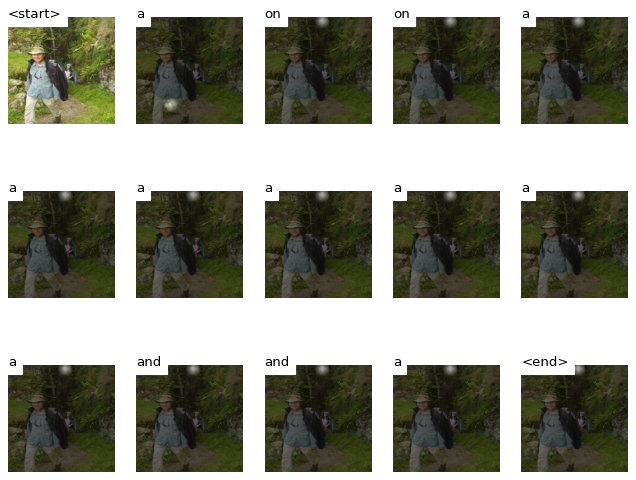

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:07<00:25,  1.72s/it]

Image file name: ../data/iaprtc12/images/22/22381.jpg


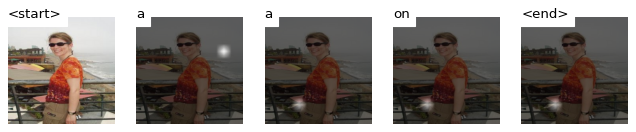

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:08<00:20,  1.43s/it]

Image file name: ../data/iaprtc12/images/10/10821.jpg


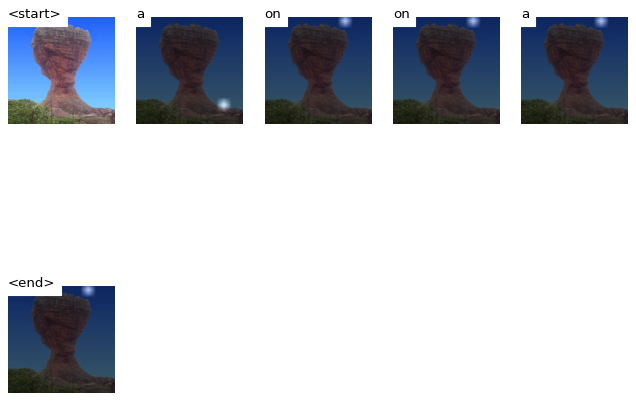

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:09<00:16,  1.27s/it]

Image file name: ../data/iaprtc12/images/18/18448.jpg


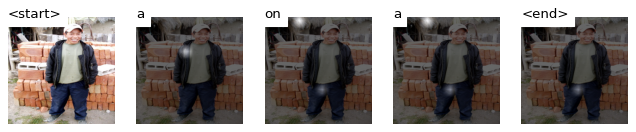

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:10<00:13,  1.14s/it]

Image file name: ../data/iaprtc12/images/17/17173.jpg


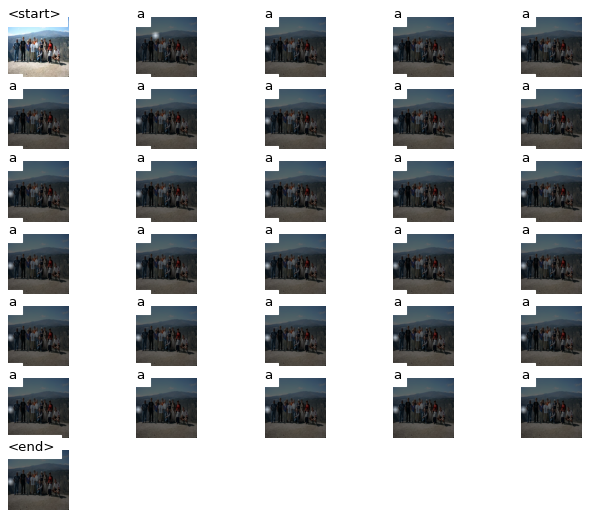

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:14<00:23,  2.11s/it]

Image file name: ../data/iaprtc12/images/13/13152.jpg


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:15<00:16,  1.62s/it]

No caption could be generated for ../data/iaprtc12/images/20/20272.jpg.


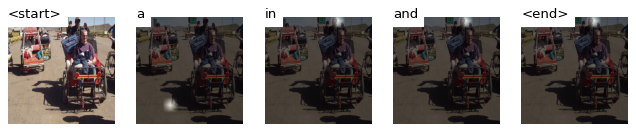

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:16<00:12,  1.37s/it]

Image file name: ../data/iaprtc12/images/11/11310.jpg


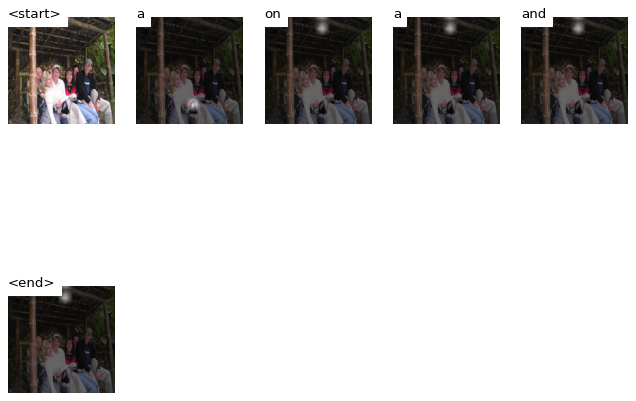

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:17<00:09,  1.24s/it]

Image file name: ../data/iaprtc12/images/14/14183.jpg


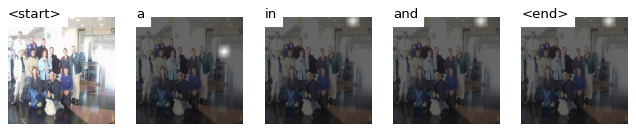

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:18<00:08,  1.20s/it]

Image file name: ../data/iaprtc12/images/10/10622.jpg


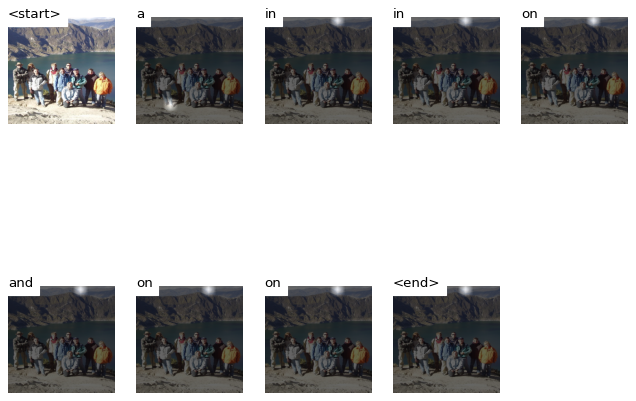

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:19<00:07,  1.24s/it]

Image file name: ../data/iaprtc12/images/13/13123.jpg


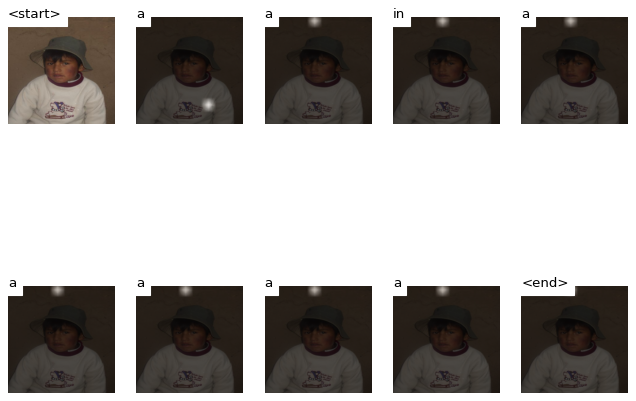

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:21<00:06,  1.31s/it]

Image file name: ../data/iaprtc12/images/19/19181.jpg


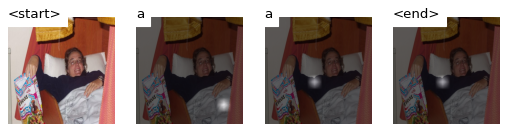

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:21<00:04,  1.12s/it]

Image file name: ../data/iaprtc12/images/16/16920.jpg


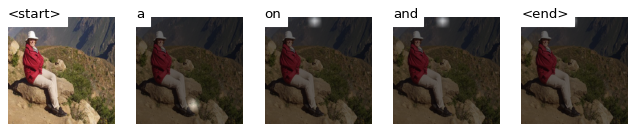

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:22<00:03,  1.03s/it]

Image file name: ../data/iaprtc12/images/11/11308.jpg


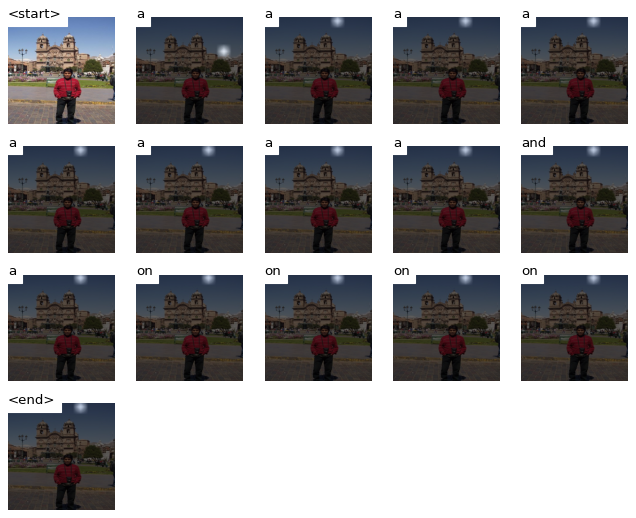

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:25<00:03,  1.54s/it]

Image file name: ../data/iaprtc12/images/14/14016.jpg


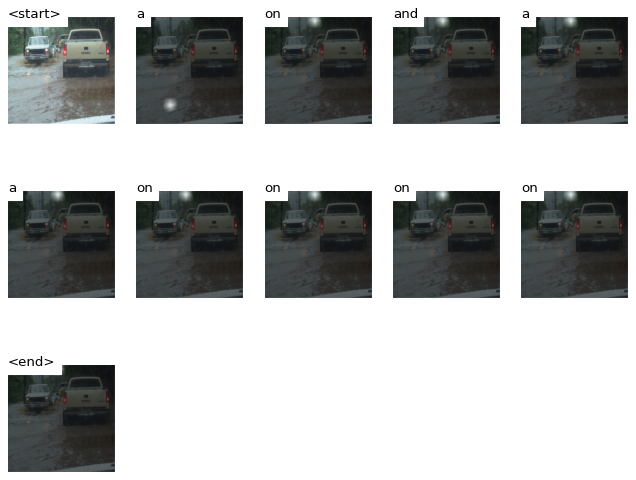

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:27<00:01,  1.64s/it]

Image file name: ../data/iaprtc12/images/21/21029.jpg


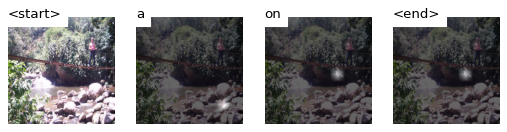

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:27<00:00,  1.39s/it]

Image file name: ../data/iaprtc12/images/18/18355.jpg


In [41]:
# CLEF unfiltered
for batch in tqdm(test_dataloader_clef_unf, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:10,  1.81it/s]

No caption could be generated for ../data/iaprtc12/images/40/40416.jpg.


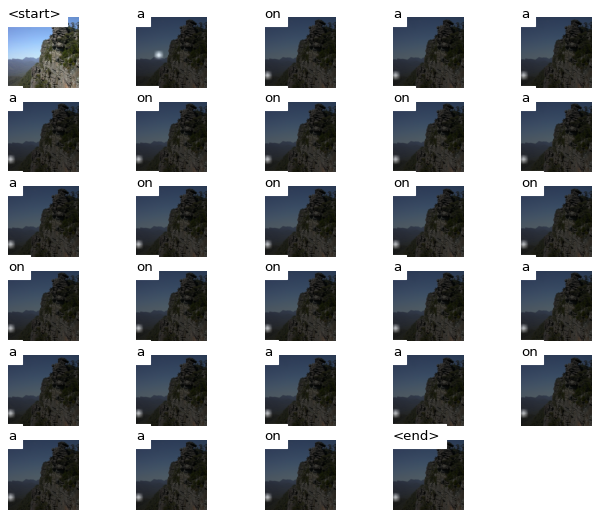

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:04<00:45,  2.54s/it]

Image file name: ../data/iaprtc12/images/39/39158.jpg


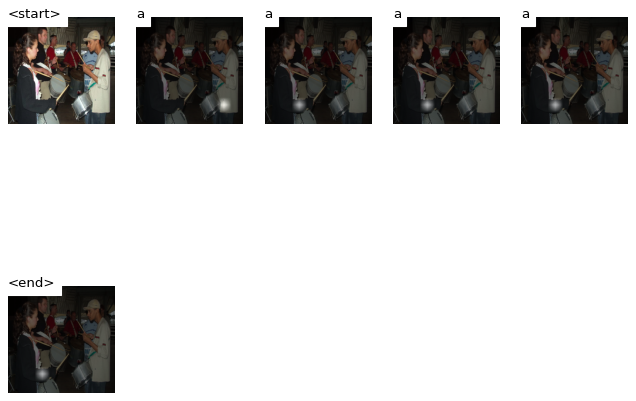

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:05<00:30,  1.80s/it]

Image file name: ../data/iaprtc12/images/25/25053.jpg


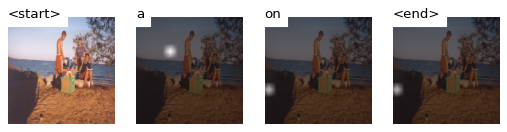

Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:06<00:22,  1.39s/it]

Image file name: ../data/iaprtc12/images/30/30620.jpg


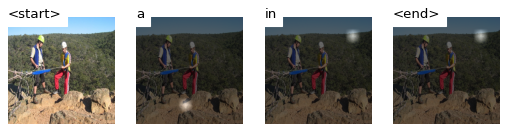

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:07<00:18,  1.22s/it]

Image file name: ../data/iaprtc12/images/32/32397.jpg


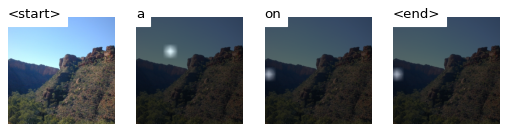

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:08<00:16,  1.15s/it]

Image file name: ../data/iaprtc12/images/38/38937.jpg


Generating captions and attention...:  35%|████████████████                              | 7/20 [00:08<00:12,  1.05it/s]

No caption could be generated for ../data/iaprtc12/images/39/39005.jpg.


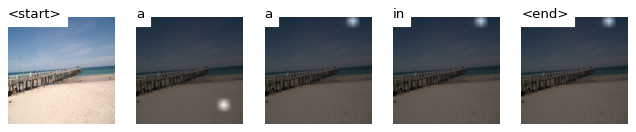

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:09<00:10,  1.10it/s]

Image file name: ../data/iaprtc12/images/40/40120.jpg


Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:10<00:08,  1.25it/s]

No caption could be generated for ../data/iaprtc12/images/23/23588.jpg.


Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:10<00:07,  1.37it/s]

No caption could be generated for ../data/iaprtc12/images/39/39472.jpg.


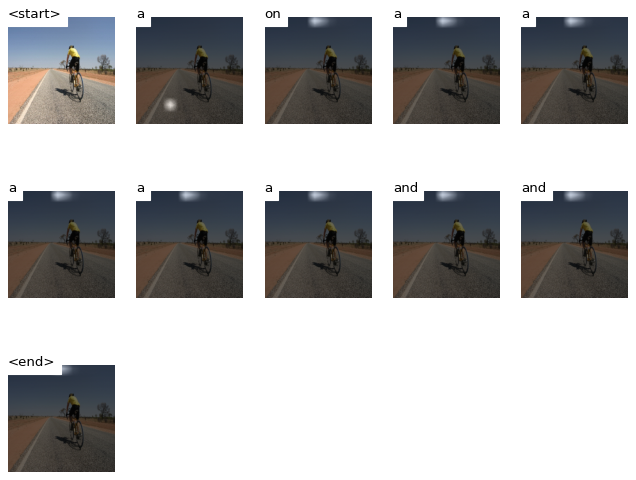

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:12<00:09,  1.01s/it]

Image file name: ../data/iaprtc12/images/30/30138.jpg


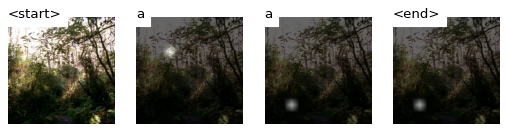

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:12<00:07,  1.10it/s]

Image file name: ../data/iaprtc12/images/40/40202.jpg


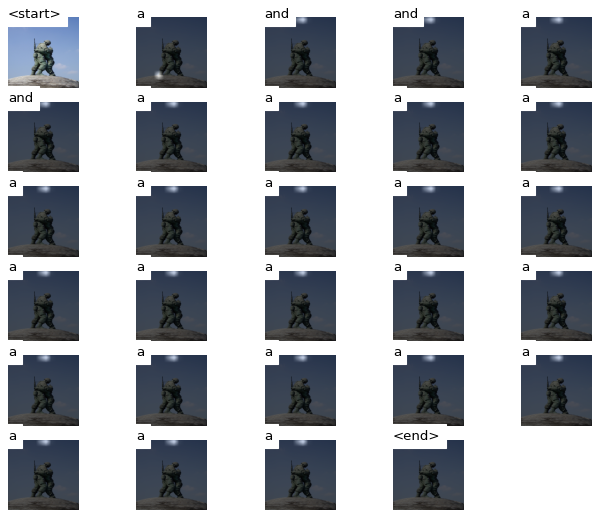

Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:17<00:13,  1.90s/it]

Image file name: ../data/iaprtc12/images/35/35895.jpg


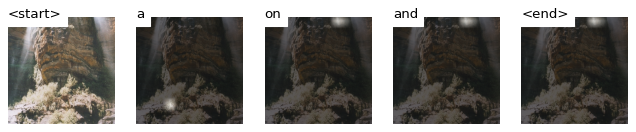

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:17<00:09,  1.57s/it]

Image file name: ../data/iaprtc12/images/32/32663.jpg


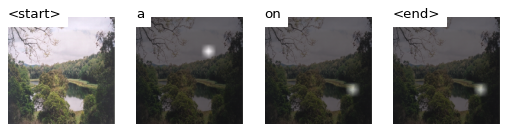

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:18<00:06,  1.30s/it]

Image file name: ../data/iaprtc12/images/30/30705.jpg


Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:19<00:04,  1.08s/it]

No caption could be generated for ../data/iaprtc12/images/38/38081.jpg.


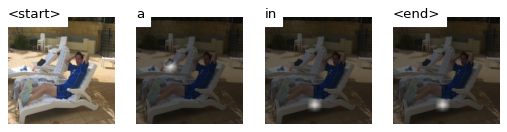

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:19<00:02,  1.05it/s]

Image file name: ../data/iaprtc12/images/31/31571.jpg


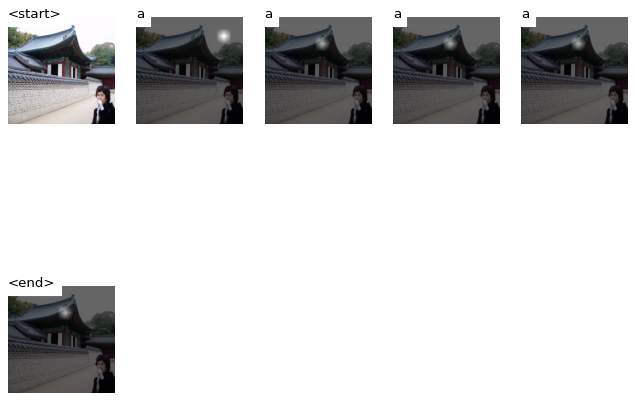

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:20<00:02,  1.01s/it]

Image file name: ../data/iaprtc12/images/35/35858.jpg


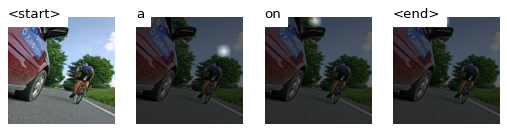

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:21<00:00,  1.09it/s]

Image file name: ../data/iaprtc12/images/37/37836.jpg


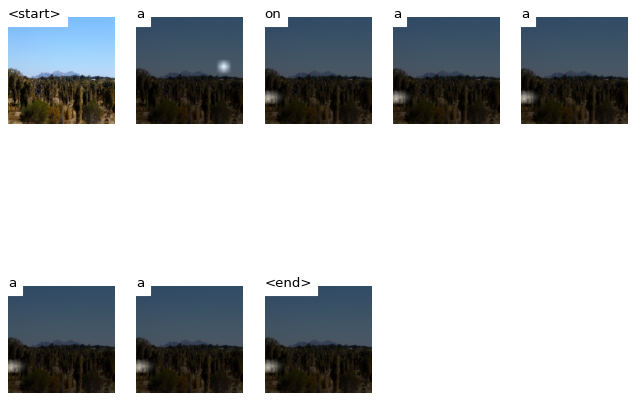

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:23<00:00,  1.15s/it]

Image file name: ../data/iaprtc12/images/39/39239.jpg


In [42]:
# CLEF filtered
for batch in tqdm(test_dataloader_clef_f, desc='Generating captions and attention...'):
    img = os.path.join(clef_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')

Generating captions and attention...:   0%|                                                      | 0/20 [00:00<?, ?it/s]

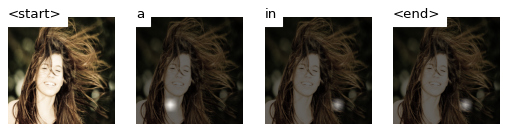

Generating captions and attention...:   5%|██▎                                           | 1/20 [00:00<00:12,  1.46it/s]

Image file name: ../data/flickr_8k/Images/2116444946_1f5d1fe5d1.jpg


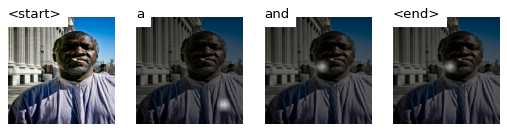

Generating captions and attention...:  10%|████▌                                         | 2/20 [00:01<00:12,  1.46it/s]

Image file name: ../data/flickr_8k/Images/2316097768_ef662f444b.jpg


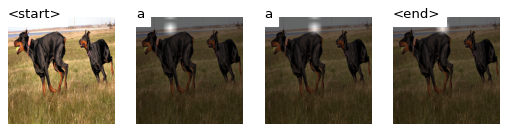

Generating captions and attention...:  15%|██████▉                                       | 3/20 [00:02<00:11,  1.46it/s]

Image file name: ../data/flickr_8k/Images/2439384468_58934deab6.jpg


Generating captions and attention...:  20%|█████████▏                                    | 4/20 [00:02<00:10,  1.50it/s]

No caption could be generated for ../data/flickr_8k/Images/2112921744_92bf706805.jpg.


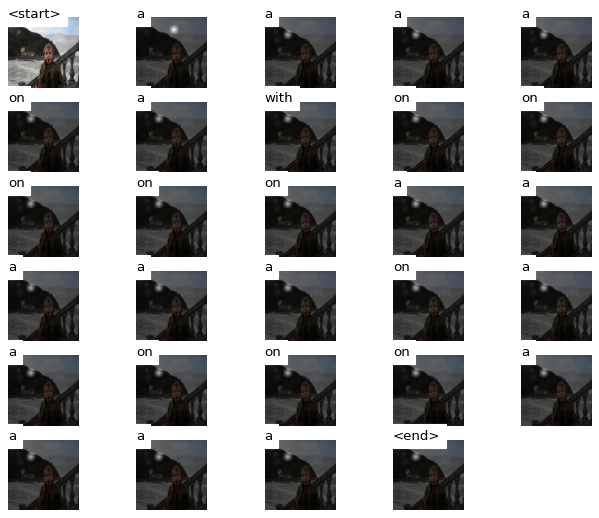

Generating captions and attention...:  25%|███████████▌                                  | 5/20 [00:06<00:29,  1.98s/it]

Image file name: ../data/flickr_8k/Images/2392460773_2aa01eb340.jpg


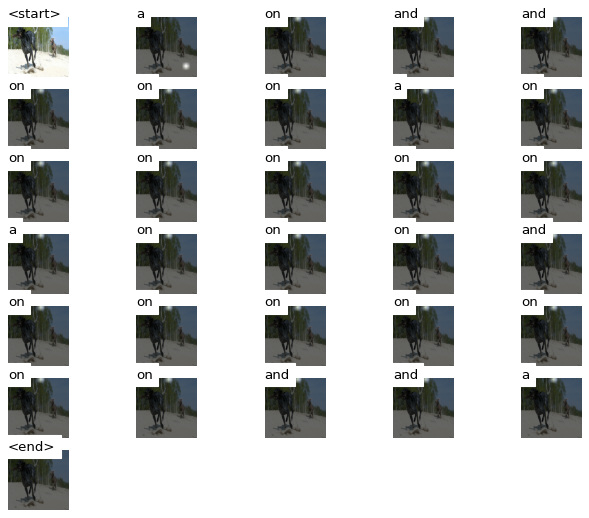

Generating captions and attention...:  30%|█████████████▊                                | 6/20 [00:11<00:37,  2.67s/it]

Image file name: ../data/flickr_8k/Images/2434006663_207a284cec.jpg


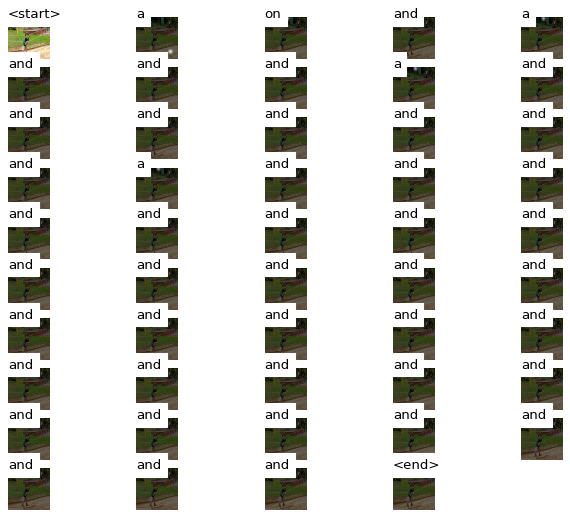

Generating captions and attention...:  35%|████████████████                              | 7/20 [00:15<00:44,  3.41s/it]

Image file name: ../data/flickr_8k/Images/2308256827_3c0a7d514d.jpg


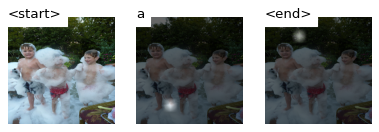

Generating captions and attention...:  40%|██████████████████▍                           | 8/20 [00:16<00:29,  2.50s/it]

Image file name: ../data/flickr_8k/Images/2111360187_d2505437b7.jpg


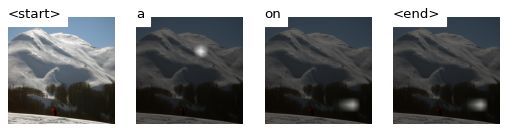

Generating captions and attention...:  45%|████████████████████▋                         | 9/20 [00:17<00:21,  1.93s/it]

Image file name: ../data/flickr_8k/Images/2271671533_7538ccd556.jpg


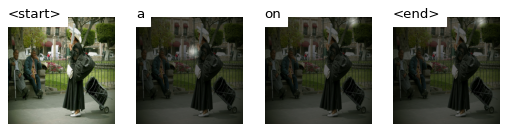

Generating captions and attention...:  50%|██████████████████████▌                      | 10/20 [00:17<00:15,  1.54s/it]

Image file name: ../data/flickr_8k/Images/2328616978_fb21be2b87.jpg


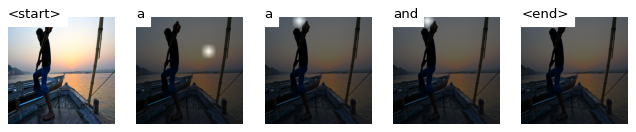

Generating captions and attention...:  55%|████████████████████████▊                    | 11/20 [00:19<00:13,  1.46s/it]

Image file name: ../data/flickr_8k/Images/2456907314_49bc4591c4.jpg


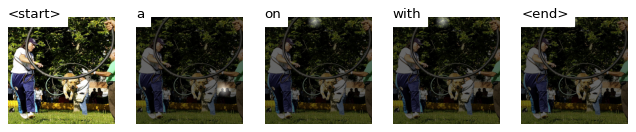

Generating captions and attention...:  60%|███████████████████████████                  | 12/20 [00:19<00:10,  1.26s/it]

Image file name: ../data/flickr_8k/Images/2229179070_dc8ea8582e.jpg


Generating captions and attention...:  65%|█████████████████████████████▎               | 13/20 [00:20<00:07,  1.04s/it]

No caption could be generated for ../data/flickr_8k/Images/2279980395_989d48ae72.jpg.


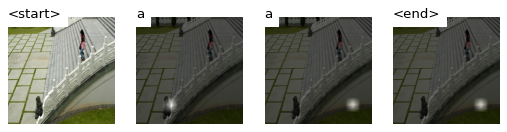

Generating captions and attention...:  70%|███████████████████████████████▍             | 14/20 [00:21<00:05,  1.08it/s]

Image file name: ../data/flickr_8k/Images/2393971707_bce01ae754.jpg


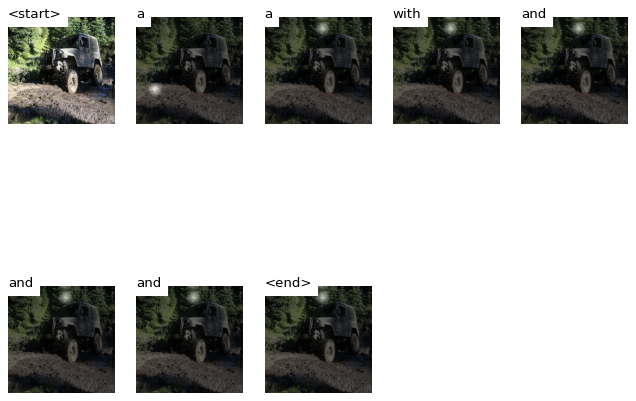

Generating captions and attention...:  75%|█████████████████████████████████▊           | 15/20 [00:22<00:05,  1.02s/it]

Image file name: ../data/flickr_8k/Images/211277478_7d43aaee09.jpg


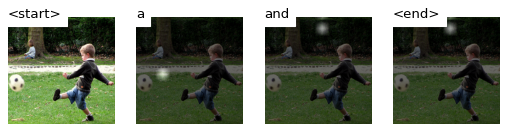

Generating captions and attention...:  80%|████████████████████████████████████         | 16/20 [00:23<00:03,  1.08it/s]

Image file name: ../data/flickr_8k/Images/2337919839_df83827fa0.jpg


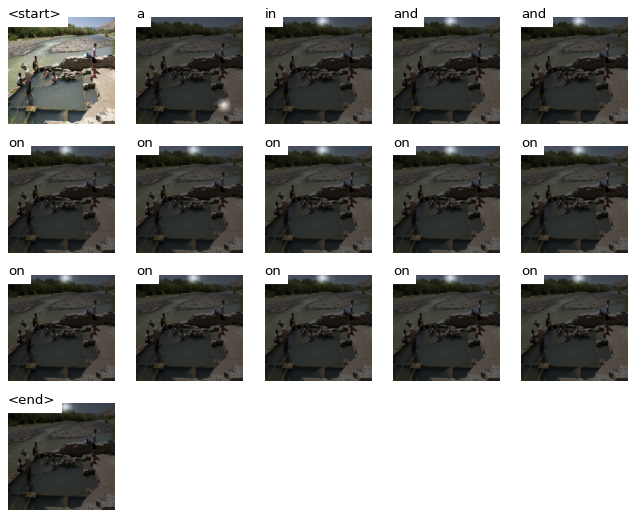

Generating captions and attention...:  85%|██████████████████████████████████████▎      | 17/20 [00:25<00:04,  1.38s/it]

Image file name: ../data/flickr_8k/Images/2447035752_415f4bb152.jpg


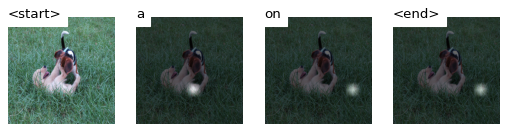

Generating captions and attention...:  90%|████████████████████████████████████████▌    | 18/20 [00:26<00:02,  1.17s/it]

Image file name: ../data/flickr_8k/Images/23445819_3a458716c1.jpg


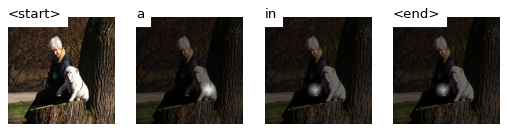

Generating captions and attention...:  95%|██████████████████████████████████████████▊  | 19/20 [00:26<00:01,  1.03s/it]

Image file name: ../data/flickr_8k/Images/2448210587_9fe7ea5f42.jpg


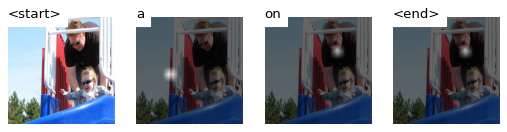

Generating captions and attention...: 100%|█████████████████████████████████████████████| 20/20 [00:27<00:00,  1.38s/it]

Image file name: ../data/flickr_8k/Images/2445654384_4ee3e486e1.jpg


In [43]:
# flickr
for batch in tqdm(test_dataloader_flickr, desc='Generating captions and attention...'):
    img = os.path.join(flickr_image_dir, batch['image_paths'][0])
    try:
        tester.test_images(img, hyperparameters['beam_size'], hyperparameters['smooth'])
        print(f'Image file name: {img}')
    except ValueError as e:
        #plt.imshow(Image.open(img).resize([24 * 38, 24 * 38], Image.LANCZOS))
        print(f'No caption could be generated for {img}.')